<a href="https://colab.research.google.com/github/john-cant/AMLS_24_25_SNJCCAN57/blob/main/Task_CNN_Base_100325.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>



# AMLS2 Assignment
## Task A: BASE CNN

Explore CNN based classifiers LR > HR dataset.

## Import libraries
The required libraries for this notebook are sklearn, copy, numpy and matplotlib.

In [15]:
## first enable autoreload during development so latest (new) version local code library is reloaded on execution
## can be commented out when local code development not happening to avoid overhead
%load_ext autoreload
%autoreload 2

from psutil import virtual_memory
ram_gb = virtual_memory().total / 1e9
print('Your runtime has {:.1f} gigabytes of available RAM\n'.format(ram_gb))

if ram_gb < 20:
  print('Not using a high-RAM runtime')
else:
  print('You are using a high-RAM runtime!')

gpu_info = !nvidia-smi
gpu_info = '\n'.join(gpu_info)
if gpu_info.find('failed') >= 0:
  print('Not connected to a GPU')
else:
  print(gpu_info)

## import libraries
import io
##import openpyxl
import glob
import os
import numpy as np
import matplotlib.pyplot as plt

from google.colab import drive
if not os.path.exists('/content/drive/My Drive'):   ## check if Google drive mounted
    from google.colab import drive
    drive.mount('/content/drive')
else:
    print("Google Drive is already mounted.")
import sys
sys.path.append('/content/drive/My Drive/AMLS2')    ## load project directory
###print(os.listdir('/content/drive/My Drive/AMLS2'))  ## check by listing files
## local code library
import AMLS_common as ac

## import tensorflow
import tensorflow as tf
from tensorflow.keras.models import Sequential, Model
from tensorflow.keras.layers import GlobalAveragePooling2D, Dense, Multiply, Add, Layer, Lambda, LeakyReLU
from tensorflow.keras.layers import Input, Conv2D, Flatten, UpSampling2D, Dropout, BatchNormalization, PReLU
from tensorflow.keras.optimizers import Adam, SGD, RMSprop
from tensorflow.keras.losses import BinaryCrossentropy, Hinge, MeanAbsoluteError
from tensorflow.keras.applications import MobileNetV2
from tensorflow.keras.initializers import Constant
from tensorflow.keras.applications.vgg19 import VGG19
import tensorflow.keras.backend as K
from tensorflow.nn import depth_to_space

from skimage.metrics import structural_similarity as ssim


The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload
Your runtime has 89.6 gigabytes of available RAM

You are using a high-RAM runtime!
Sat Mar 15 13:28:33 2025       
+-----------------------------------------------------------------------------------------+
| NVIDIA-SMI 550.54.15              Driver Version: 550.54.15      CUDA Version: 12.4     |
|-----------------------------------------+------------------------+----------------------+
| GPU  Name                 Persistence-M | Bus-Id          Disp.A | Volatile Uncorr. ECC |
| Fan  Temp   Perf          Pwr:Usage/Cap |           Memory-Usage | GPU-Util  Compute M. |
|                                         |                        |               MIG M. |
|=========================================+========================+======================|
|   0  NVIDIA A100-SXM4-40GB          Off |   00000000:00:04.0 Off |                    0 |
| N/A   37C    P0             53W /  400W |   33695MiB /  40

## Set base parameters
Including hyperparameters and environment specifics

In [16]:
## Initialize hyperparameters
filename = "param_base_030325.xlsx"
if os.path.isfile(filename):
    item = ac.HyperParameters.load_excel(filename)
else:
    print(filename+" does not exist. Loading default hyperparameters instead")
    item      = ac.HyperParameters(learning_rate=0.01,
                                   kernel_size=3,
                                   num_epochs=75,
                                   num_filter=128,
                                   layers=4,
                                   dropout_rate=0.25,
                                   optimise="Adam",
                                   strides=2,
                                   padding="same",
                                   loss="sparse_categorical_crossentropy")
print(ac.HyperParameters.list_parameters(item))

tqdm_callback = ac.TqdmEpochProgress(total_epochs=item.num_epochs)

param_base_030325.xlsx does not exist. Loading default hyperparameters instead
learning_rate: 0.01
kernel_size: 3
num_epochs: 75
optimise: Adam
loss: sparse_categorical_crossentropy
num_filter: 128
strides: 2
padding: same
dropout_rate: 0.25
layers: 4
default_activation: relu



In [17]:
## control (e.g. verbose) parameters
filebase   = "/content/drive/My Drive/AMLS2/metrics/"          ## place to save output files
verbose    = 1                   ## to control whether additional in process information is printed

In [18]:
### define functions required
class ResizeLayer(Layer):
    def __init__(self, target_size, **kwargs):
        super(ResizeLayer, self).__init__(**kwargs)
        self.target_size = target_size

    def call(self, inputs):
        return tf.image.resize(inputs, self.target_size)

def display_lr_hr_pairs(dataset, num_samples=5):
    """
    Displays LR-HR image pairs from a dataset without using OpenCV.

    Parameters:
        dataset (tf.data.Dataset): The dataset containing (LR, HR) pairs.
        num_samples (int): Number of pairs to display.
    """
    # Get a batch of images
    lowres_batch, highres_batch = next(iter(dataset))

    # Convert tensors to NumPy for visualization
    lowres_batch = lowres_batch.numpy()
    highres_batch = highres_batch.numpy()

    # Plot the images
    plt.figure(figsize=(10, num_samples * 3))
    for i in range(num_samples):
        plt.subplot(num_samples, 2, 2 * i + 1)
        plt.imshow(lowres_batch[i])  # Show LR image
        plt.axis("off")
        plt.title("Low-Res")

        plt.subplot(num_samples, 2, 2 * i + 2)
        plt.imshow(highres_batch[i])  # Show HR image
        plt.axis("off")
        plt.title("High-Res")

    plt.show()

def load_image_pair(lr_path, hr_path):
    """
    Loads a low-resolution (LR) and high-resolution (HR) image pair as tensors.
    """
    # Load LR image
    lr = tf.io.read_file(lr_path)
    lr = tf.image.decode_png(lr, channels=3)
    lr = tf.image.convert_image_dtype(lr, tf.float32)  # Normalize to [0,1]

    # Resize LR image to MobileNet input size
    lr = tf.image.resize(lr, [IMG_SIZE, IMG_SIZE])

    # Load HR image
    hr = tf.io.read_file(hr_path)
    hr = tf.image.decode_png(hr, channels=3)
    hr = tf.image.convert_image_dtype(hr, tf.float32)  # Normalize to [0,1]
    # Do we resize HR image to keep its original resolution for training
    ##hr = tf.image.resize(hr, [IMG_SIZE, IMG_SIZE])
    hr = tf.image.resize(hr, [IMG_SIZE * UPSCALE_FACTOR, IMG_SIZE * UPSCALE_FACTOR])  # Resize HR to 4x LR size

    return lr, hr  # Return both as tensors

#######################################################################################
def plot_results(lowres, preds):
    """
    Displays low-resolution image and super-resolution image
    """
    plt.figure(figsize=(12, 6))

    # Ensure pixel values are within valid range [0,1]
    lowres = np.clip(lowres, 0, 1)
    preds  = np.clip(preds, 0, 1)

    plt.subplot(1, 2, 1)
    plt.imshow(lowres)
    plt.title("Low-resolution")

    plt.subplot(1, 2, 2)
    plt.imshow(preds)
    plt.title("Prediction (Super-Resolution)")

    plt.show()

## Define perceptual loss outside the training loop
# Load pre-trained VGG19 model (only once, outside the function)
vgg = VGG19(include_top=False, weights='imagenet', input_shape=(224, 224, 3))
# input_shape should match your image dimensions
# Extract features from a specific layer
loss_model = Model(inputs=vgg.input, outputs=vgg.get_layer('block5_conv4').output)
loss_model.trainable = False  # Freeze VGG19 weights

def swish(x):
    return x * tf.keras.activations.sigmoid(x)

def perceptual_loss(y_true, y_pred):
    """
    Calculates the perceptual loss using VGG19 features.

    Args:
        y_true: Ground truth high-resolution image.
        y_pred: Predicted high-resolution image.

    Returns:
        Perceptual loss value.
    """
    # Resize y_true and y_pred to (224, 224) before passing to loss_model
    y_true = tf.image.resize(y_true, (224, 224))
    y_pred = tf.image.resize(y_pred, (224, 224))

    # Calculate perceptual loss using the pre-loaded loss_model
    return tf.reduce_mean(tf.square(loss_model(y_true) - loss_model(y_pred)))

def se_block(input_tensor, ratio=16):
    """Squeeze-and-Excitation block for feature enhancement."""
    filters = input_tensor.shape[-1]
    se = GlobalAveragePooling2D()(input_tensor)
    se = Dense(filters // ratio, activation="relu")(se)
    se = Dense(filters, activation="sigmoid")(se)
    return Multiply()([input_tensor, se])

def residual_block(x):
    """A small ResNet-like block."""
    res = Conv2D(64, (3, 3), padding="same")(x)
    res = BatchNormalization()(res)
    res = PReLU(shared_axes=[1, 2])(res)
    res = Conv2D(64, (3, 3), padding="same")(res)
    res = BatchNormalization()(res)
    return Add()([x, res])  # Skip connection

def srresnet(num_res_blocks: int = 16):
    """
    Creates SRResNet model.

    Parameters
    ----------
    num_res_blocks: int
        Number of residual blocks in the model
        Default=16

    Returns
    -------
        SRResNet Model object.
    """
    def PReLU_activation(name):
        return PReLU(Constant(value=0.25), shared_axes=[1,2], name=name)

    def residual_block(layer_input, filters, block_number):
        """Residual block described in paper"""
        d = Conv2D(filters, kernel_size=3, strides=1, padding='same', name=f"conv_res_{block_number}_1")(layer_input)
        d = PReLU_activation(f"prelu_res_{block_number}")(d)
        d = BatchNormalization(momentum=0.8, name=f"BN_res_{block_number}_1")(d)
        d = Conv2D(filters, kernel_size=3, strides=1, padding='same', name=f"conv_res_{block_number}_2")(d)
        d = BatchNormalization(momentum=0.8, name=f"BN_res_{block_number}_2")(d)
        d = Add(name=f"add_res_{block_number}")([d, layer_input])
        return d

    def upsample_block(layer_input, scale, i):
      """
      """
      u = Conv2D(256, kernel_size=3, strides=1, padding='same', name=f"conv_up_{i}")(layer_input)
      # Wrap depth_to_space in a Lambda layer
      u = Lambda(lambda x: depth_to_space(x, 2), name=f"pix_shuf_{i}")(u)
      return PReLU_activation(name=f"prelu_up_{i}")(u)

 ##   def upsample_block(layer_input, scale, i) :
 ##       u = Conv2D(256, kernel_size=3, strides=1, padding='same', name=f"conv_up_{i}")(layer_input)
 ##       u = depth_to_space(u, 2, name=f"pix_shuf_{i}")
 ##       return PReLU_activation(name=f"prelu_up_{i}")(u)

    # ==================
    # Model Construction
    # ==================

    lr_image = Input(shape=(None, None, 3))
    c1 = Conv2D(64, kernel_size=9, strides=1, padding='same', name="Conv_ip")(lr_image)
    c1 = PReLU_activation(name="prelu_ip")(c1)

    r = residual_block(c1, 64, 0)
    for i in range(1,num_res_blocks):
      r = residual_block(r, 64, i)

    c2 = Conv2D(64, kernel_size=3, strides=1, padding='same', name="conv_out")(r)
    c2 = BatchNormalization(momentum=0.8, name="BN_out")(c2)
    c2 = Add(name="add_out")([c2, c1])

    u1 = upsample_block(c2, 2, 1)
    u2 = upsample_block(u1, 2, 2)

    c3 = Conv2D(3, kernel_size=9, strides=1, padding='same', activation="sigmoid", name="conv_final")(u2)

    return Model(lr_image, c3, name="SRResNet")

def edsr(num_filters: int = 64, num_res_blocks: int = 16):
    """
    Creates an EDSR model.

    Parameters
    ----------
    num_filters: int
        Number of filters per convolution layer.
        Default=64

    num_res_blocks: int
        Number of residual blocks in the model
        Default=16

    Returns
    -------
        EDSR Model object.
    """
    DIV2K_RGB_MEAN = np.array([0.4488, 0.4371, 0.4040]) * 255
    normalize = lambda x: (x - DIV2K_RGB_MEAN) / 127.5
    denormalize = lambda x: x * 127.5 + DIV2K_RGB_MEAN
    pixel_shuffle = lambda x: depth_to_space(x, 2)

    def residual_block(layer_input, filters, block_number):
        """Residual block described in paper"""
        d = Conv2D(filters, kernel_size=3, strides=1, padding='same', activation='relu', name=f"conv_res_{block_number}_1")(layer_input)
        d = Conv2D(filters, kernel_size=3, strides=1, padding='same', name=f"conv_res_{block_number}_2")(d)
        d = Add(name=f"add_res_{block_number}")([d, layer_input])
        return d

    def upsample_block(layer_input, i) :
        u = Conv2D(num_filters*4, kernel_size=3, strides=1, padding='same', name=f"conv_up_{i}")(layer_input)
        u = Lambda(pixel_shuffle, name=f"pix_shuf_{i}")(u)
        return u

    # ==================
    # Model Construction
    # ==================

    x_in = Input(shape=(None, None, 3), name="LR Batch")
    x = Lambda(normalize, name="normalize_input")(x_in)

    x = r = Conv2D(num_filters, 3, padding='same', name="Conv_ip")(x)
    for i in range(num_res_blocks):
        r = residual_block(r, num_filters, i)

    c2 = Conv2D(num_filters, 3, padding='same', name="conv_out")(r)
    c2 = Add(name="add_out")([x, c2])

    u1 = upsample_block(c2, 1)
    u2 = upsample_block(u1, 2)
    c3 = Conv2D(3, 3, padding='same', name="conv_final")(u2)

    x_out = Lambda(denormalize, name="denormalize_output")(c3)
    return Model(x_in, x_out, name="EDSR")

def calculate_psnr(firstImage, secondImage):
   # Compute the difference between corresponding pixels
   diff = np.subtract(firstImage, secondImage)
   # Get the square of the difference
   squared_diff = np.square(diff)

   # Compute the mean squared error
   mse = np.mean(squared_diff)

   # Compute the PSNR
   max_pixel = 255
   psnr = 20 * np.log10(max_pixel) - 10 * np.log10(mse)

   return psnr

def ssim_loss(y_true, y_pred):
    return 1 - tf.image.ssim(y_true, y_pred, max_val=1.0)



## Load and preprocess the Data
We load the dataset.

In [19]:
## Loading the data file using a loader
data_flag      = 'X4'        # defines which dataset to load
CROP_SIZE      = 224  # HR crop size
UPSCALE_FACTOR = 4  # Factor between LR and HR
IMG_SIZE       = 224
BATCH_SIZE     = 8
# Define training folder paths
lr_train_folder = "/content/drive/My Drive/AMLS2/dataset/train/LR/DIV2K_train_LR_bicubic_X2"
hr_train_folder = "/content/drive/My Drive/AMLS2/dataset/train/HR/DIV2K_train_HR"

# Get sorted list of image paths (ensures they match correctly)
lr_train_images = sorted(glob.glob(lr_train_folder + "/*.png"))
hr_train_images = sorted(glob.glob(hr_train_folder + "/*.png"))

# Make sure we have the same number of images
print("Training image lengths",len(lr_train_images),len(hr_train_images))
assert len(lr_train_images) == len(hr_train_images), "Mismatch between LR and HR train images!"

# Define validation folder paths
lr_val_folder = "/content/drive/My Drive/AMLS2/dataset/val/LR/DIV2K_valid_LR_bicubic_X2"
hr_val_folder = "/content/drive/My Drive/AMLS2/dataset/val/HR/DIV2K_valid_HR"

# Get sorted list of image paths (ensures they match correctly)
lr_val_images = sorted(glob.glob(lr_val_folder + "/*.png"))
hr_val_images = sorted(glob.glob(hr_val_folder + "/*.png"))

##print(os.listdir(lr_val_folder))  ## check by listing files
# Make sure we have the same number of images
print("Validation image lengths",len(lr_val_images),len(hr_val_images))
assert len(lr_val_images) == len(hr_val_images), "Mismatch between LR and HR validation images!"

print("end load")
### end tested load

Training image lengths 800 800
Validation image lengths 100 100
end load


In [20]:
### step 2
# Get sorted lists of training image paths
lr_train_paths = sorted(tf.io.gfile.glob(lr_train_folder + "/*.png"))
hr_train_paths = sorted(tf.io.gfile.glob(hr_train_folder + "/*.png"))

# Create TensorFlow dataset of paths
lr_dataset = tf.data.Dataset.from_tensor_slices(lr_train_paths)
hr_dataset = tf.data.Dataset.from_tensor_slices(hr_train_paths)

# Zip the datasets together to create (LR, HR) pairs
train_dataset = tf.data.Dataset.zip((lr_dataset, hr_dataset))

# Map the function to load images
train_dataset = train_dataset.map(load_image_pair, num_parallel_calls=tf.data.AUTOTUNE)

# Batch and shuffle the dataset
train_dataset = train_dataset.batch(BATCH_SIZE).shuffle(100).prefetch(tf.data.AUTOTUNE)

# Get sorted lists of validation image paths
lr_val_paths = sorted(tf.io.gfile.glob(lr_val_folder + "/*.png"))
hr_val_paths = sorted(tf.io.gfile.glob(hr_val_folder + "/*.png"))

# Create TensorFlow dataset of paths
lr_dataset = tf.data.Dataset.from_tensor_slices(lr_val_paths)
hr_dataset = tf.data.Dataset.from_tensor_slices(hr_val_paths)

# Zip the datasets together to create (LR, HR) pairs
val_dataset = tf.data.Dataset.zip((lr_dataset, hr_dataset))
print(len(val_dataset))
# Map the function to load images
val_dataset = val_dataset.map(load_image_pair, num_parallel_calls=tf.data.AUTOTUNE)

# Batch and shuffle the dataset
val_dataset = val_dataset.batch(BATCH_SIZE).shuffle(100).prefetch(tf.data.AUTOTUNE)

verbose = 1
if verbose == 1:
    ## print summary stats for training dataset
    print("\nSummary metrics for train_dataset")
    print("type:",type(train_dataset))
    print("length:",len(train_dataset))
    print("shape:",train_dataset)

### end step2

100

Summary metrics for train_dataset
type: <class 'tensorflow.python.data.ops.prefetch_op._PrefetchDataset'>
length: 100
shape: <_PrefetchDataset element_spec=(TensorSpec(shape=(None, 224, 224, 3), dtype=tf.float32, name=None), TensorSpec(shape=(None, 896, 896, 3), dtype=tf.float32, name=None))>


In [21]:
# Call function to display first BATCH_SIZE pairs
##print("Training image pairs")
##display_lr_hr_pairs(train_dataset, num_samples=BATCH_SIZE)
##print("Validation image pairs")
##display_lr_hr_pairs(val_dataset,num_samples=BATCH_SIZE)

# Resize the input images to (224, 224) to match the expected input size for MobileNetV2
##input_layer = Input(shape=(224, 224, 3))

# If input images are not (224, 224), resize them to (224, 224)
##resized_input = ResizeLayer(target_size=(224, 224))(input_layer)



## Define the CNN model

Define a base model

In [22]:
## Define the model
choice = "1"

if choice == "1":
  ## batch_size = 4
  model = srresnet(32)
  model.compile(optimizer=tf.keras.optimizers.Adam(learning_rate=0.0001), # Use item.learning_rate
                loss= ssim_loss,  # ssim loss
                metrics=['acc'])
if choice == "2":
  model = edsr(64,32)
  model.compile(optimizer=tf.keras.optimizers.Adam(learning_rate=0.0001), # Use item.learning_rate
                loss= 'mean_absolute_error',  # MAE loss
                metrics=['acc'])

print(model.summary())
## Redirect the summary output to a string
summary_string = io.StringIO()
model.summary(print_fn=lambda x: summary_string.write(x + "\n"))
summary_content = summary_string.getvalue()
summary_string.close()

Model: "SRResNet"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)              ┃ Output Shape           ┃        Param # ┃ Connected to           ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━┩
│ input_layer_4             │ (None, None, None, 3)  │              0 │ -                      │
│ (InputLayer)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ Conv_ip (Conv2D)          │ (None, None, None, 64) │         15,616 │ input_layer_4[0][0]    │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ prelu_ip (PReLU)          │ (None, None, None, 64) │             64 │ Conv_ip[0][0]          │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv_res_0_1 (Conv2D)     │ (None, None, None, 64) │         36,928 │ prelu_ip[0][0]         │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ prelu_res_0 (PReLU)       │ (None, None, None, 64) │             64 │ conv_res_0_1[0][0]     │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ BN_res_0_1                │ (None, None, None, 64) │            256 │ prelu_res_0[0][0]      │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv_res_0_2 (Conv2D)     │ (None, None, None, 64) │         36,928 │ BN_res_0_1[0][0]       │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ BN_res_0_2                │ (None, None, None, 64) │            256 │ conv_res_0_2[0][0]     │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ add_res_0 (Add)           │ (None, None, None, 64) │              0 │ BN_res_0_2[0][0],      │
│                           │                        │                │ prelu_ip[0][0]         │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv_res_1_1 (Conv2D)     │ (None, None, None, 64) │         36,928 │ add_res_0[0][0]        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ prelu_res_1 (PReLU)       │ (None, None, None, 64) │             64 │ conv_res_1_1[0][0]     │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ BN_res_1_1                │ (None, None, None, 64) │            256 │ prelu_res_1[0][0]      │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv_res_1_2 (Conv2D)     │ (None, None, None, 64) │         36,928 │ BN_res_1_1[0][0]       │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ BN_res_1_2                │ (None, None, None, 64) │            256 │ conv_res_1_2[0][0]     │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ add_res_1 (Add)           │ (None, None, None, 64) │              0 │ BN_res_1_2[0][0],      │
│                           │                        │                │ add_res_0[0][0]        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv_res_2_1 (Conv2D)     │ (None, None, None, 64) │         36,928 │ add_res_1[0][0]        │
├──────────────────────

 Total params: 2,745,795 (10.47 MB)

 Trainable params: 2,737,475 (10.44 MB)

 Non-trainable params: 8,320 (32.50 KB)

None


## Fit the model

Fit using hyperparameters as defined above

In [23]:
## Fit the model
if verbose == 1:
    print(item.num_epochs)

## steps_per_epoch = len(train_dataset) // BATCH_SIZE  ## Adjust based on dataset size
## validation_steps = len(val_dataset) // BATCH_SIZE   ## Adjust for validation

steps_per_epoch  = len(train_dataset)  ## Understand dataset already adjusted by batch
validation_steps = len(val_dataset)    ## Also set up validation

print("steps",steps_per_epoch,"val_steps",validation_steps)

history = model.fit(
    train_dataset,
    epochs=item.num_epochs,
    steps_per_epoch=steps_per_epoch,
    validation_data=val_dataset,
    validation_steps=validation_steps,
    verbose=1,                                  ## Set to 1 for progress updates
    callbacks=[tqdm_callback]
)


75
steps 100 val_steps 13



Epoch Progress:   0%|          | 0/75 [00:00<?, ?epoch/s]

Epoch 1/75
100/100 ━━━━━━━━━━━━━━━━━━━━ 0s 371ms/step - acc: 0.3488 - loss: 0.6232


Epoch Progress:   1%|▏         | 1/75 [02:13<2:44:23, 133.29s/epoch, acc=0.385, loss=0.505, val_acc=0.457, val_loss=0.373]

100/100 ━━━━━━━━━━━━━━━━━━━━ 133s 539ms/step - acc: 0.3491 - loss: 0.6220 - val_acc: 0.4575 - val_loss: 0.3726
Epoch 2/75
100/100 ━━━━━━━━━━━━━━━━━━━━ 0s 371ms/step - acc: 0.5180 - loss: 0.3713


Epoch Progress:   3%|▎         | 2/75 [03:05<1:44:06, 85.57s/epoch, acc=0.569, loss=0.361, val_acc=0.62, val_loss=0.336] 

100/100 ━━━━━━━━━━━━━━━━━━━━ 52s 402ms/step - acc: 0.5185 - loss: 0.3712 - val_acc: 0.6198 - val_loss: 0.3362
Epoch 3/75
100/100 ━━━━━━━━━━━━━━━━━━━━ 0s 371ms/step - acc: 0.6520 - loss: 0.3361


Epoch Progress:   4%|▍         | 3/75 [03:57<1:24:19, 70.27s/epoch, acc=0.668, loss=0.341, val_acc=0.676, val_loss=0.321]

100/100 ━━━━━━━━━━━━━━━━━━━━ 52s 400ms/step - acc: 0.6522 - loss: 0.3362 - val_acc: 0.6755 - val_loss: 0.3210
Epoch 4/75
100/100 ━━━━━━━━━━━━━━━━━━━━ 0s 371ms/step - acc: 0.6816 - loss: 0.3332


Epoch Progress:   5%|▌         | 4/75 [04:49<1:14:39, 63.09s/epoch, acc=0.678, loss=0.333, val_acc=0.677, val_loss=0.317]

100/100 ━━━━━━━━━━━━━━━━━━━━ 52s 400ms/step - acc: 0.6815 - loss: 0.3332 - val_acc: 0.6767 - val_loss: 0.3171
Epoch 5/75
100/100 ━━━━━━━━━━━━━━━━━━━━ 0s 371ms/step - acc: 0.6837 - loss: 0.3277


Epoch Progress:   7%|▋         | 5/75 [05:41<1:08:59, 59.13s/epoch, acc=0.682, loss=0.329, val_acc=0.663, val_loss=0.319]

100/100 ━━━━━━━━━━━━━━━━━━━━ 52s 401ms/step - acc: 0.6837 - loss: 0.3277 - val_acc: 0.6627 - val_loss: 0.3185
Epoch 6/75
100/100 ━━━━━━━━━━━━━━━━━━━━ 0s 371ms/step - acc: 0.6641 - loss: 0.3241


Epoch Progress:   8%|▊         | 6/75 [06:33<1:05:14, 56.74s/epoch, acc=0.677, loss=0.328, val_acc=0.675, val_loss=0.317]

100/100 ━━━━━━━━━━━━━━━━━━━━ 52s 401ms/step - acc: 0.6642 - loss: 0.3241 - val_acc: 0.6750 - val_loss: 0.3173
Epoch 7/75
100/100 ━━━━━━━━━━━━━━━━━━━━ 0s 371ms/step - acc: 0.6927 - loss: 0.3277


Epoch Progress:   9%|▉         | 7/75 [07:25<1:02:35, 55.22s/epoch, acc=0.695, loss=0.324, val_acc=0.669, val_loss=0.309]

100/100 ━━━━━━━━━━━━━━━━━━━━ 52s 401ms/step - acc: 0.6927 - loss: 0.3277 - val_acc: 0.6691 - val_loss: 0.3089
Epoch 8/75
100/100 ━━━━━━━━━━━━━━━━━━━━ 0s 371ms/step - acc: 0.7160 - loss: 0.3247


Epoch Progress:  11%|█         | 8/75 [08:18<1:00:33, 54.24s/epoch, acc=0.729, loss=0.319, val_acc=0.717, val_loss=0.305]

100/100 ━━━━━━━━━━━━━━━━━━━━ 52s 400ms/step - acc: 0.7161 - loss: 0.3246 - val_acc: 0.7174 - val_loss: 0.3049
Epoch 9/75
100/100 ━━━━━━━━━━━━━━━━━━━━ 0s 371ms/step - acc: 0.7485 - loss: 0.3110


Epoch Progress:  12%|█▏        | 9/75 [09:10<58:57, 53.60s/epoch, acc=0.747, loss=0.315, val_acc=0.786, val_loss=0.303]

100/100 ━━━━━━━━━━━━━━━━━━━━ 52s 402ms/step - acc: 0.7485 - loss: 0.3110 - val_acc: 0.7859 - val_loss: 0.3025
Epoch 10/75
100/100 ━━━━━━━━━━━━━━━━━━━━ 0s 371ms/step - acc: 0.7383 - loss: 0.3143


Epoch Progress:  13%|█▎        | 10/75 [10:02<57:33, 53.13s/epoch, acc=0.749, loss=0.314, val_acc=0.773, val_loss=0.299]

100/100 ━━━━━━━━━━━━━━━━━━━━ 52s 401ms/step - acc: 0.7384 - loss: 0.3143 - val_acc: 0.7727 - val_loss: 0.2989
Epoch 11/75
100/100 ━━━━━━━━━━━━━━━━━━━━ 0s 371ms/step - acc: 0.7483 - loss: 0.3064


Epoch Progress:  15%|█▍        | 11/75 [10:54<56:20, 52.82s/epoch, acc=0.757, loss=0.31, val_acc=0.656, val_loss=0.314] 

100/100 ━━━━━━━━━━━━━━━━━━━━ 52s 400ms/step - acc: 0.7484 - loss: 0.3064 - val_acc: 0.6564 - val_loss: 0.3136
Epoch 12/75
100/100 ━━━━━━━━━━━━━━━━━━━━ 0s 371ms/step - acc: 0.7668 - loss: 0.2975


Epoch Progress:  16%|█▌        | 12/75 [11:46<55:12, 52.59s/epoch, acc=0.765, loss=0.306, val_acc=0.755, val_loss=0.302]

100/100 ━━━━━━━━━━━━━━━━━━━━ 52s 400ms/step - acc: 0.7668 - loss: 0.2976 - val_acc: 0.7554 - val_loss: 0.3021
Epoch 13/75
100/100 ━━━━━━━━━━━━━━━━━━━━ 0s 371ms/step - acc: 0.7695 - loss: 0.3065


Epoch Progress:  17%|█▋        | 13/75 [12:38<54:10, 52.43s/epoch, acc=0.764, loss=0.302, val_acc=0.748, val_loss=0.299]

100/100 ━━━━━━━━━━━━━━━━━━━━ 52s 400ms/step - acc: 0.7695 - loss: 0.3065 - val_acc: 0.7480 - val_loss: 0.2990
Epoch 14/75
100/100 ━━━━━━━━━━━━━━━━━━━━ 0s 371ms/step - acc: 0.7653 - loss: 0.3060


Epoch Progress:  19%|█▊        | 14/75 [13:30<53:10, 52.30s/epoch, acc=0.766, loss=0.302, val_acc=0.742, val_loss=0.299]

100/100 ━━━━━━━━━━━━━━━━━━━━ 52s 400ms/step - acc: 0.7653 - loss: 0.3059 - val_acc: 0.7420 - val_loss: 0.2991
Epoch 15/75
100/100 ━━━━━━━━━━━━━━━━━━━━ 0s 371ms/step - acc: 0.7589 - loss: 0.2994


Epoch Progress:  20%|██        | 15/75 [14:22<52:13, 52.22s/epoch, acc=0.766, loss=0.299, val_acc=0.736, val_loss=0.302]

100/100 ━━━━━━━━━━━━━━━━━━━━ 52s 400ms/step - acc: 0.7589 - loss: 0.2994 - val_acc: 0.7360 - val_loss: 0.3017
Epoch 16/75
100/100 ━━━━━━━━━━━━━━━━━━━━ 0s 371ms/step - acc: 0.7764 - loss: 0.2970


Epoch Progress:  21%|██▏       | 16/75 [15:14<51:18, 52.18s/epoch, acc=0.771, loss=0.297, val_acc=0.733, val_loss=0.295]

100/100 ━━━━━━━━━━━━━━━━━━━━ 52s 400ms/step - acc: 0.7763 - loss: 0.2970 - val_acc: 0.7334 - val_loss: 0.2952
Epoch 17/75
100/100 ━━━━━━━━━━━━━━━━━━━━ 0s 371ms/step - acc: 0.7614 - loss: 0.2986


Epoch Progress:  23%|██▎       | 17/75 [16:07<50:29, 52.23s/epoch, acc=0.771, loss=0.295, val_acc=0.763, val_loss=0.298]

100/100 ━━━━━━━━━━━━━━━━━━━━ 52s 402ms/step - acc: 0.7615 - loss: 0.2985 - val_acc: 0.7629 - val_loss: 0.2975
Epoch 18/75
100/100 ━━━━━━━━━━━━━━━━━━━━ 0s 371ms/step - acc: 0.7822 - loss: 0.2987


Epoch Progress:  24%|██▍       | 18/75 [16:59<49:34, 52.19s/epoch, acc=0.777, loss=0.295, val_acc=0.752, val_loss=0.293]

100/100 ━━━━━━━━━━━━━━━━━━━━ 52s 401ms/step - acc: 0.7822 - loss: 0.2986 - val_acc: 0.7521 - val_loss: 0.2928
Epoch 19/75
100/100 ━━━━━━━━━━━━━━━━━━━━ 0s 371ms/step - acc: 0.7713 - loss: 0.3016


Epoch Progress:  25%|██▌       | 19/75 [17:51<48:41, 52.17s/epoch, acc=0.782, loss=0.292, val_acc=0.803, val_loss=0.289]

100/100 ━━━━━━━━━━━━━━━━━━━━ 52s 400ms/step - acc: 0.7714 - loss: 0.3015 - val_acc: 0.8029 - val_loss: 0.2892
Epoch 20/75
100/100 ━━━━━━━━━━━━━━━━━━━━ 0s 371ms/step - acc: 0.7765 - loss: 0.2926


Epoch Progress:  27%|██▋       | 20/75 [18:43<47:47, 52.13s/epoch, acc=0.781, loss=0.292, val_acc=0.771, val_loss=0.29] 

100/100 ━━━━━━━━━━━━━━━━━━━━ 52s 400ms/step - acc: 0.7766 - loss: 0.2926 - val_acc: 0.7709 - val_loss: 0.2896
Epoch 21/75
100/100 ━━━━━━━━━━━━━━━━━━━━ 0s 371ms/step - acc: 0.7866 - loss: 0.2931


Epoch Progress:  28%|██▊       | 21/75 [19:35<46:53, 52.10s/epoch, acc=0.787, loss=0.29, val_acc=0.781, val_loss=0.287]

100/100 ━━━━━━━━━━━━━━━━━━━━ 52s 400ms/step - acc: 0.7866 - loss: 0.2931 - val_acc: 0.7813 - val_loss: 0.2871
Epoch 22/75
100/100 ━━━━━━━━━━━━━━━━━━━━ 0s 371ms/step - acc: 0.7819 - loss: 0.2908


Epoch Progress:  29%|██▉       | 22/75 [20:27<45:59, 52.07s/epoch, acc=0.783, loss=0.289, val_acc=0.782, val_loss=0.289]

100/100 ━━━━━━━━━━━━━━━━━━━━ 52s 401ms/step - acc: 0.7819 - loss: 0.2908 - val_acc: 0.7822 - val_loss: 0.2894
Epoch 23/75
100/100 ━━━━━━━━━━━━━━━━━━━━ 0s 371ms/step - acc: 0.7891 - loss: 0.2811


Epoch Progress:  31%|███       | 23/75 [21:19<45:09, 52.10s/epoch, acc=0.789, loss=0.288, val_acc=0.811, val_loss=0.288]

100/100 ━━━━━━━━━━━━━━━━━━━━ 52s 400ms/step - acc: 0.7891 - loss: 0.2812 - val_acc: 0.8109 - val_loss: 0.2882
Epoch 24/75
100/100 ━━━━━━━━━━━━━━━━━━━━ 0s 371ms/step - acc: 0.8046 - loss: 0.2910


Epoch Progress:  32%|███▏      | 24/75 [22:11<44:15, 52.08s/epoch, acc=0.789, loss=0.286, val_acc=0.787, val_loss=0.285]

100/100 ━━━━━━━━━━━━━━━━━━━━ 52s 400ms/step - acc: 0.8045 - loss: 0.2910 - val_acc: 0.7869 - val_loss: 0.2850
Epoch 25/75
100/100 ━━━━━━━━━━━━━━━━━━━━ 0s 371ms/step - acc: 0.7949 - loss: 0.2815


Epoch Progress:  33%|███▎      | 25/75 [23:03<43:24, 52.09s/epoch, acc=0.794, loss=0.284, val_acc=0.76, val_loss=0.284] 

100/100 ━━━━━━━━━━━━━━━━━━━━ 52s 400ms/step - acc: 0.7949 - loss: 0.2815 - val_acc: 0.7598 - val_loss: 0.2842
Epoch 26/75
100/100 ━━━━━━━━━━━━━━━━━━━━ 0s 371ms/step - acc: 0.7928 - loss: 0.2847


Epoch Progress:  35%|███▍      | 26/75 [23:55<42:33, 52.11s/epoch, acc=0.797, loss=0.284, val_acc=0.776, val_loss=0.283]

100/100 ━━━━━━━━━━━━━━━━━━━━ 52s 401ms/step - acc: 0.7929 - loss: 0.2847 - val_acc: 0.7756 - val_loss: 0.2833
Epoch 27/75
100/100 ━━━━━━━━━━━━━━━━━━━━ 0s 371ms/step - acc: 0.7880 - loss: 0.2874


Epoch Progress:  36%|███▌      | 27/75 [24:47<41:37, 52.03s/epoch, acc=0.795, loss=0.285, val_acc=0.708, val_loss=0.282]

100/100 ━━━━━━━━━━━━━━━━━━━━ 52s 400ms/step - acc: 0.7881 - loss: 0.2874 - val_acc: 0.7079 - val_loss: 0.2820
Epoch 28/75
100/100 ━━━━━━━━━━━━━━━━━━━━ 0s 371ms/step - acc: 0.8140 - loss: 0.2800


Epoch Progress:  37%|███▋      | 28/75 [25:39<40:45, 52.04s/epoch, acc=0.808, loss=0.283, val_acc=0.809, val_loss=0.284]

100/100 ━━━━━━━━━━━━━━━━━━━━ 52s 400ms/step - acc: 0.8140 - loss: 0.2800 - val_acc: 0.8087 - val_loss: 0.2836
Epoch 29/75
100/100 ━━━━━━━━━━━━━━━━━━━━ 0s 371ms/step - acc: 0.7936 - loss: 0.2857


Epoch Progress:  39%|███▊      | 29/75 [26:31<39:53, 52.03s/epoch, acc=0.804, loss=0.281, val_acc=0.81, val_loss=0.28]  

100/100 ━━━━━━━━━━━━━━━━━━━━ 52s 400ms/step - acc: 0.7937 - loss: 0.2856 - val_acc: 0.8105 - val_loss: 0.2798
Epoch 30/75
100/100 ━━━━━━━━━━━━━━━━━━━━ 0s 371ms/step - acc: 0.8055 - loss: 0.2847


Epoch Progress:  40%|████      | 30/75 [27:23<39:01, 52.03s/epoch, acc=0.81, loss=0.28, val_acc=0.754, val_loss=0.283]

100/100 ━━━━━━━━━━━━━━━━━━━━ 52s 400ms/step - acc: 0.8056 - loss: 0.2847 - val_acc: 0.7538 - val_loss: 0.2828
Epoch 31/75
100/100 ━━━━━━━━━━━━━━━━━━━━ 0s 371ms/step - acc: 0.7948 - loss: 0.2789


Epoch Progress:  41%|████▏     | 31/75 [28:15<38:08, 52.01s/epoch, acc=0.808, loss=0.28, val_acc=0.805, val_loss=0.282]

100/100 ━━━━━━━━━━━━━━━━━━━━ 52s 401ms/step - acc: 0.7949 - loss: 0.2790 - val_acc: 0.8047 - val_loss: 0.2817
Epoch 32/75
100/100 ━━━━━━━━━━━━━━━━━━━━ 0s 371ms/step - acc: 0.8058 - loss: 0.2803


Epoch Progress:  43%|████▎     | 32/75 [29:07<37:16, 52.01s/epoch, acc=0.807, loss=0.279, val_acc=0.791, val_loss=0.28]

100/100 ━━━━━━━━━━━━━━━━━━━━ 52s 400ms/step - acc: 0.8058 - loss: 0.2803 - val_acc: 0.7909 - val_loss: 0.2800
Epoch 33/75
100/100 ━━━━━━━━━━━━━━━━━━━━ 0s 371ms/step - acc: 0.8023 - loss: 0.2811


Epoch Progress:  44%|████▍     | 33/75 [29:59<36:24, 52.02s/epoch, acc=0.811, loss=0.279, val_acc=0.814, val_loss=0.278]

100/100 ━━━━━━━━━━━━━━━━━━━━ 52s 400ms/step - acc: 0.8024 - loss: 0.2811 - val_acc: 0.8141 - val_loss: 0.2784
Epoch 34/75
100/100 ━━━━━━━━━━━━━━━━━━━━ 0s 371ms/step - acc: 0.8209 - loss: 0.2780


Epoch Progress:  45%|████▌     | 34/75 [30:51<35:33, 52.05s/epoch, acc=0.819, loss=0.278, val_acc=0.799, val_loss=0.278]

100/100 ━━━━━━━━━━━━━━━━━━━━ 52s 400ms/step - acc: 0.8209 - loss: 0.2780 - val_acc: 0.7990 - val_loss: 0.2783
Epoch 35/75
100/100 ━━━━━━━━━━━━━━━━━━━━ 0s 371ms/step - acc: 0.8115 - loss: 0.2697


Epoch Progress:  47%|████▋     | 35/75 [31:43<34:42, 52.06s/epoch, acc=0.819, loss=0.276, val_acc=0.772, val_loss=0.285]

100/100 ━━━━━━━━━━━━━━━━━━━━ 52s 401ms/step - acc: 0.8116 - loss: 0.2698 - val_acc: 0.7720 - val_loss: 0.2846
Epoch 36/75
100/100 ━━━━━━━━━━━━━━━━━━━━ 0s 371ms/step - acc: 0.8178 - loss: 0.2722


Epoch Progress:  48%|████▊     | 36/75 [32:35<33:49, 52.04s/epoch, acc=0.821, loss=0.276, val_acc=0.78, val_loss=0.278] 

100/100 ━━━━━━━━━━━━━━━━━━━━ 52s 400ms/step - acc: 0.8178 - loss: 0.2723 - val_acc: 0.7798 - val_loss: 0.2779
Epoch 37/75
100/100 ━━━━━━━━━━━━━━━━━━━━ 0s 371ms/step - acc: 0.8138 - loss: 0.2737


Epoch Progress:  49%|████▉     | 37/75 [33:27<32:57, 52.03s/epoch, acc=0.822, loss=0.275, val_acc=0.803, val_loss=0.277]

100/100 ━━━━━━━━━━━━━━━━━━━━ 52s 400ms/step - acc: 0.8138 - loss: 0.2738 - val_acc: 0.8030 - val_loss: 0.2771
Epoch 38/75
100/100 ━━━━━━━━━━━━━━━━━━━━ 0s 371ms/step - acc: 0.8256 - loss: 0.2760


Epoch Progress:  51%|█████     | 38/75 [34:20<32:05, 52.05s/epoch, acc=0.825, loss=0.274, val_acc=0.809, val_loss=0.275]

100/100 ━━━━━━━━━━━━━━━━━━━━ 52s 400ms/step - acc: 0.8256 - loss: 0.2760 - val_acc: 0.8089 - val_loss: 0.2747
Epoch 39/75
100/100 ━━━━━━━━━━━━━━━━━━━━ 0s 371ms/step - acc: 0.8321 - loss: 0.2793


Epoch Progress:  52%|█████▏    | 39/75 [35:12<31:14, 52.06s/epoch, acc=0.826, loss=0.274, val_acc=0.832, val_loss=0.275]

100/100 ━━━━━━━━━━━━━━━━━━━━ 52s 400ms/step - acc: 0.8320 - loss: 0.2793 - val_acc: 0.8320 - val_loss: 0.2747
Epoch 40/75
100/100 ━━━━━━━━━━━━━━━━━━━━ 0s 371ms/step - acc: 0.8232 - loss: 0.2709


Epoch Progress:  53%|█████▎    | 40/75 [36:04<30:20, 52.02s/epoch, acc=0.822, loss=0.273, val_acc=0.805, val_loss=0.274]

100/100 ━━━━━━━━━━━━━━━━━━━━ 52s 400ms/step - acc: 0.8232 - loss: 0.2710 - val_acc: 0.8052 - val_loss: 0.2737
Epoch 41/75
100/100 ━━━━━━━━━━━━━━━━━━━━ 0s 371ms/step - acc: 0.8142 - loss: 0.2768


Epoch Progress:  55%|█████▍    | 41/75 [36:56<29:29, 52.05s/epoch, acc=0.822, loss=0.273, val_acc=0.824, val_loss=0.275]

100/100 ━━━━━━━━━━━━━━━━━━━━ 52s 400ms/step - acc: 0.8143 - loss: 0.2768 - val_acc: 0.8237 - val_loss: 0.2752
Epoch 42/75
100/100 ━━━━━━━━━━━━━━━━━━━━ 0s 371ms/step - acc: 0.8271 - loss: 0.2717


Epoch Progress:  56%|█████▌    | 42/75 [37:48<28:37, 52.06s/epoch, acc=0.826, loss=0.273, val_acc=0.79, val_loss=0.274] 

100/100 ━━━━━━━━━━━━━━━━━━━━ 52s 400ms/step - acc: 0.8271 - loss: 0.2717 - val_acc: 0.7900 - val_loss: 0.2737
Epoch 43/75
100/100 ━━━━━━━━━━━━━━━━━━━━ 0s 371ms/step - acc: 0.8300 - loss: 0.2745


Epoch Progress:  57%|█████▋    | 43/75 [38:40<27:45, 52.05s/epoch, acc=0.829, loss=0.274, val_acc=0.796, val_loss=0.274]

100/100 ━━━━━━━━━━━━━━━━━━━━ 52s 400ms/step - acc: 0.8299 - loss: 0.2745 - val_acc: 0.7963 - val_loss: 0.2742
Epoch 44/75
100/100 ━━━━━━━━━━━━━━━━━━━━ 0s 371ms/step - acc: 0.8216 - loss: 0.2708


Epoch Progress:  59%|█████▊    | 44/75 [39:32<26:53, 52.05s/epoch, acc=0.826, loss=0.272, val_acc=0.846, val_loss=0.272]

100/100 ━━━━━━━━━━━━━━━━━━━━ 52s 401ms/step - acc: 0.8217 - loss: 0.2708 - val_acc: 0.8463 - val_loss: 0.2720
Epoch 45/75
100/100 ━━━━━━━━━━━━━━━━━━━━ 0s 371ms/step - acc: 0.8214 - loss: 0.2763


Epoch Progress:  60%|██████    | 45/75 [40:24<26:00, 52.02s/epoch, acc=0.823, loss=0.271, val_acc=0.776, val_loss=0.275]

100/100 ━━━━━━━━━━━━━━━━━━━━ 52s 400ms/step - acc: 0.8214 - loss: 0.2762 - val_acc: 0.7762 - val_loss: 0.2745
Epoch 46/75
100/100 ━━━━━━━━━━━━━━━━━━━━ 0s 371ms/step - acc: 0.8276 - loss: 0.2678


Epoch Progress:  61%|██████▏   | 46/75 [41:16<25:09, 52.04s/epoch, acc=0.831, loss=0.27, val_acc=0.819, val_loss=0.272] 

100/100 ━━━━━━━━━━━━━━━━━━━━ 52s 400ms/step - acc: 0.8276 - loss: 0.2678 - val_acc: 0.8194 - val_loss: 0.2724
Epoch 47/75
100/100 ━━━━━━━━━━━━━━━━━━━━ 0s 371ms/step - acc: 0.8357 - loss: 0.2677


Epoch Progress:  63%|██████▎   | 47/75 [42:08<24:17, 52.05s/epoch, acc=0.838, loss=0.269, val_acc=0.778, val_loss=0.272]

100/100 ━━━━━━━━━━━━━━━━━━━━ 52s 400ms/step - acc: 0.8357 - loss: 0.2678 - val_acc: 0.7784 - val_loss: 0.2721
Epoch 48/75
100/100 ━━━━━━━━━━━━━━━━━━━━ 0s 371ms/step - acc: 0.8327 - loss: 0.2663


Epoch Progress:  64%|██████▍   | 48/75 [43:00<23:26, 52.08s/epoch, acc=0.838, loss=0.269, val_acc=0.793, val_loss=0.271]

100/100 ━━━━━━━━━━━━━━━━━━━━ 52s 401ms/step - acc: 0.8328 - loss: 0.2663 - val_acc: 0.7934 - val_loss: 0.2715
Epoch 49/75
100/100 ━━━━━━━━━━━━━━━━━━━━ 0s 371ms/step - acc: 0.8200 - loss: 0.2710


Epoch Progress:  65%|██████▌   | 49/75 [43:52<22:32, 52.03s/epoch, acc=0.823, loss=0.27, val_acc=0.808, val_loss=0.272] 

100/100 ━━━━━━━━━━━━━━━━━━━━ 52s 400ms/step - acc: 0.8200 - loss: 0.2710 - val_acc: 0.8076 - val_loss: 0.2724
Epoch 50/75
100/100 ━━━━━━━━━━━━━━━━━━━━ 0s 371ms/step - acc: 0.8334 - loss: 0.2660


Epoch Progress:  67%|██████▋   | 50/75 [44:44<21:41, 52.04s/epoch, acc=0.832, loss=0.269, val_acc=0.793, val_loss=0.269]

100/100 ━━━━━━━━━━━━━━━━━━━━ 52s 400ms/step - acc: 0.8334 - loss: 0.2661 - val_acc: 0.7932 - val_loss: 0.2693
Epoch 51/75
100/100 ━━━━━━━━━━━━━━━━━━━━ 0s 371ms/step - acc: 0.8335 - loss: 0.2670


Epoch Progress:  68%|██████▊   | 51/75 [45:36<20:49, 52.04s/epoch, acc=0.837, loss=0.268, val_acc=0.839, val_loss=0.269]

100/100 ━━━━━━━━━━━━━━━━━━━━ 52s 400ms/step - acc: 0.8335 - loss: 0.2670 - val_acc: 0.8394 - val_loss: 0.2685
Epoch 52/75
100/100 ━━━━━━━━━━━━━━━━━━━━ 0s 371ms/step - acc: 0.8433 - loss: 0.2654


Epoch Progress:  69%|██████▉   | 52/75 [46:28<19:56, 52.04s/epoch, acc=0.841, loss=0.267, val_acc=0.827, val_loss=0.268]

100/100 ━━━━━━━━━━━━━━━━━━━━ 52s 400ms/step - acc: 0.8432 - loss: 0.2654 - val_acc: 0.8272 - val_loss: 0.2683
Epoch 53/75
100/100 ━━━━━━━━━━━━━━━━━━━━ 0s 371ms/step - acc: 0.8432 - loss: 0.2621


Epoch Progress:  71%|███████   | 53/75 [47:20<19:05, 52.07s/epoch, acc=0.837, loss=0.267, val_acc=0.817, val_loss=0.268]

100/100 ━━━━━━━━━━━━━━━━━━━━ 52s 401ms/step - acc: 0.8431 - loss: 0.2621 - val_acc: 0.8167 - val_loss: 0.2677
Epoch 54/75
100/100 ━━━━━━━━━━━━━━━━━━━━ 0s 371ms/step - acc: 0.8388 - loss: 0.2678


Epoch Progress:  72%|███████▏  | 54/75 [48:12<18:12, 52.04s/epoch, acc=0.84, loss=0.266, val_acc=0.797, val_loss=0.268] 

100/100 ━━━━━━━━━━━━━━━━━━━━ 52s 400ms/step - acc: 0.8389 - loss: 0.2678 - val_acc: 0.7975 - val_loss: 0.2682
Epoch 55/75
100/100 ━━━━━━━━━━━━━━━━━━━━ 0s 371ms/step - acc: 0.8416 - loss: 0.2635


Epoch Progress:  73%|███████▎  | 55/75 [49:04<17:20, 52.05s/epoch, acc=0.837, loss=0.267, val_acc=0.791, val_loss=0.268]

100/100 ━━━━━━━━━━━━━━━━━━━━ 52s 401ms/step - acc: 0.8416 - loss: 0.2635 - val_acc: 0.7914 - val_loss: 0.2681
Epoch 56/75
100/100 ━━━━━━━━━━━━━━━━━━━━ 0s 371ms/step - acc: 0.8431 - loss: 0.2645


Epoch Progress:  75%|███████▍  | 56/75 [49:56<16:29, 52.06s/epoch, acc=0.843, loss=0.266, val_acc=0.773, val_loss=0.267]

100/100 ━━━━━━━━━━━━━━━━━━━━ 52s 400ms/step - acc: 0.8431 - loss: 0.2645 - val_acc: 0.7735 - val_loss: 0.2671
Epoch 57/75
100/100 ━━━━━━━━━━━━━━━━━━━━ 0s 371ms/step - acc: 0.8264 - loss: 0.2626


Epoch Progress:  76%|███████▌  | 57/75 [50:49<15:37, 52.08s/epoch, acc=0.837, loss=0.266, val_acc=0.835, val_loss=0.266]

100/100 ━━━━━━━━━━━━━━━━━━━━ 52s 401ms/step - acc: 0.8265 - loss: 0.2626 - val_acc: 0.8352 - val_loss: 0.2659
Epoch 58/75
100/100 ━━━━━━━━━━━━━━━━━━━━ 0s 371ms/step - acc: 0.8434 - loss: 0.2655


Epoch Progress:  77%|███████▋  | 58/75 [51:41<14:44, 52.05s/epoch, acc=0.845, loss=0.266, val_acc=0.816, val_loss=0.271]

100/100 ━━━━━━━━━━━━━━━━━━━━ 52s 400ms/step - acc: 0.8434 - loss: 0.2655 - val_acc: 0.8156 - val_loss: 0.2709
Epoch 59/75
100/100 ━━━━━━━━━━━━━━━━━━━━ 0s 371ms/step - acc: 0.8417 - loss: 0.2652


Epoch Progress:  79%|███████▊  | 59/75 [52:33<13:52, 52.04s/epoch, acc=0.842, loss=0.265, val_acc=0.815, val_loss=0.266]

100/100 ━━━━━━━━━━━━━━━━━━━━ 52s 400ms/step - acc: 0.8417 - loss: 0.2652 - val_acc: 0.8155 - val_loss: 0.2665
Epoch 60/75
100/100 ━━━━━━━━━━━━━━━━━━━━ 0s 371ms/step - acc: 0.8356 - loss: 0.2628


Epoch Progress:  80%|████████  | 60/75 [53:25<13:00, 52.03s/epoch, acc=0.842, loss=0.265, val_acc=0.805, val_loss=0.267]

100/100 ━━━━━━━━━━━━━━━━━━━━ 52s 400ms/step - acc: 0.8357 - loss: 0.2628 - val_acc: 0.8055 - val_loss: 0.2668
Epoch 61/75
100/100 ━━━━━━━━━━━━━━━━━━━━ 0s 371ms/step - acc: 0.8513 - loss: 0.2575


Epoch Progress:  81%|████████▏ | 61/75 [54:17<12:08, 52.04s/epoch, acc=0.848, loss=0.263, val_acc=0.831, val_loss=0.266]

100/100 ━━━━━━━━━━━━━━━━━━━━ 52s 400ms/step - acc: 0.8513 - loss: 0.2576 - val_acc: 0.8309 - val_loss: 0.2656
Epoch 62/75
100/100 ━━━━━━━━━━━━━━━━━━━━ 0s 371ms/step - acc: 0.8515 - loss: 0.2589


Epoch Progress:  83%|████████▎ | 62/75 [55:09<11:16, 52.04s/epoch, acc=0.847, loss=0.264, val_acc=0.832, val_loss=0.265]

100/100 ━━━━━━━━━━━━━━━━━━━━ 52s 401ms/step - acc: 0.8515 - loss: 0.2590 - val_acc: 0.8318 - val_loss: 0.2647
Epoch 63/75
100/100 ━━━━━━━━━━━━━━━━━━━━ 0s 371ms/step - acc: 0.8463 - loss: 0.2601


Epoch Progress:  84%|████████▍ | 63/75 [56:01<10:24, 52.02s/epoch, acc=0.847, loss=0.264, val_acc=0.857, val_loss=0.266]

100/100 ━━━━━━━━━━━━━━━━━━━━ 52s 400ms/step - acc: 0.8463 - loss: 0.2601 - val_acc: 0.8571 - val_loss: 0.2662
Epoch 64/75
100/100 ━━━━━━━━━━━━━━━━━━━━ 0s 371ms/step - acc: 0.8498 - loss: 0.2625


Epoch Progress:  85%|████████▌ | 64/75 [56:53<09:32, 52.04s/epoch, acc=0.853, loss=0.263, val_acc=0.79, val_loss=0.269] 

100/100 ━━━━━━━━━━━━━━━━━━━━ 52s 400ms/step - acc: 0.8498 - loss: 0.2625 - val_acc: 0.7898 - val_loss: 0.2686
Epoch 65/75
100/100 ━━━━━━━━━━━━━━━━━━━━ 0s 371ms/step - acc: 0.8432 - loss: 0.2619


Epoch Progress:  87%|████████▋ | 65/75 [57:45<08:40, 52.05s/epoch, acc=0.844, loss=0.263, val_acc=0.869, val_loss=0.267]

100/100 ━━━━━━━━━━━━━━━━━━━━ 52s 400ms/step - acc: 0.8432 - loss: 0.2619 - val_acc: 0.8686 - val_loss: 0.2666
Epoch 66/75
100/100 ━━━━━━━━━━━━━━━━━━━━ 0s 371ms/step - acc: 0.8573 - loss: 0.2629


Epoch Progress:  88%|████████▊ | 66/75 [58:37<07:48, 52.09s/epoch, acc=0.852, loss=0.263, val_acc=0.742, val_loss=0.266]

100/100 ━━━━━━━━━━━━━━━━━━━━ 52s 401ms/step - acc: 0.8572 - loss: 0.2629 - val_acc: 0.7421 - val_loss: 0.2660
Epoch 67/75
100/100 ━━━━━━━━━━━━━━━━━━━━ 0s 371ms/step - acc: 0.8430 - loss: 0.2663


Epoch Progress:  89%|████████▉ | 67/75 [59:29<06:56, 52.02s/epoch, acc=0.844, loss=0.263, val_acc=0.842, val_loss=0.264]

100/100 ━━━━━━━━━━━━━━━━━━━━ 52s 400ms/step - acc: 0.8430 - loss: 0.2663 - val_acc: 0.8423 - val_loss: 0.2639
Epoch 68/75
100/100 ━━━━━━━━━━━━━━━━━━━━ 0s 371ms/step - acc: 0.8441 - loss: 0.2738


Epoch Progress:  91%|█████████ | 68/75 [1:00:21<06:04, 52.04s/epoch, acc=0.845, loss=0.262, val_acc=0.866, val_loss=0.263]

100/100 ━━━━━━━━━━━━━━━━━━━━ 52s 400ms/step - acc: 0.8441 - loss: 0.2737 - val_acc: 0.8662 - val_loss: 0.2628
Epoch 69/75
100/100 ━━━━━━━━━━━━━━━━━━━━ 0s 371ms/step - acc: 0.8568 - loss: 0.2570


Epoch Progress:  92%|█████████▏| 69/75 [1:01:13<05:12, 52.05s/epoch, acc=0.858, loss=0.261, val_acc=0.831, val_loss=0.263]

100/100 ━━━━━━━━━━━━━━━━━━━━ 52s 400ms/step - acc: 0.8568 - loss: 0.2571 - val_acc: 0.8314 - val_loss: 0.2629
Epoch 70/75
100/100 ━━━━━━━━━━━━━━━━━━━━ 0s 371ms/step - acc: 0.8486 - loss: 0.2698


Epoch Progress:  93%|█████████▎| 70/75 [1:02:05<04:20, 52.05s/epoch, acc=0.851, loss=0.262, val_acc=0.811, val_loss=0.265]

100/100 ━━━━━━━━━━━━━━━━━━━━ 52s 400ms/step - acc: 0.8486 - loss: 0.2697 - val_acc: 0.8108 - val_loss: 0.2647
Epoch 71/75
100/100 ━━━━━━━━━━━━━━━━━━━━ 0s 371ms/step - acc: 0.8501 - loss: 0.2589


Epoch Progress:  95%|█████████▍| 71/75 [1:02:57<03:28, 52.06s/epoch, acc=0.855, loss=0.261, val_acc=0.853, val_loss=0.265]

100/100 ━━━━━━━━━━━━━━━━━━━━ 52s 401ms/step - acc: 0.8502 - loss: 0.2589 - val_acc: 0.8529 - val_loss: 0.2654
Epoch 72/75
100/100 ━━━━━━━━━━━━━━━━━━━━ 0s 371ms/step - acc: 0.8482 - loss: 0.2621


Epoch Progress:  96%|█████████▌| 72/75 [1:03:49<02:36, 52.08s/epoch, acc=0.854, loss=0.262, val_acc=0.84, val_loss=0.263] 

100/100 ━━━━━━━━━━━━━━━━━━━━ 52s 400ms/step - acc: 0.8483 - loss: 0.2621 - val_acc: 0.8397 - val_loss: 0.2626
Epoch 73/75
100/100 ━━━━━━━━━━━━━━━━━━━━ 0s 371ms/step - acc: 0.8599 - loss: 0.2641


Epoch Progress:  97%|█████████▋| 73/75 [1:04:41<01:44, 52.06s/epoch, acc=0.858, loss=0.261, val_acc=0.806, val_loss=0.263]

100/100 ━━━━━━━━━━━━━━━━━━━━ 52s 400ms/step - acc: 0.8599 - loss: 0.2641 - val_acc: 0.8062 - val_loss: 0.2630
Epoch 74/75
100/100 ━━━━━━━━━━━━━━━━━━━━ 0s 371ms/step - acc: 0.8465 - loss: 0.2609


Epoch Progress:  99%|█████████▊| 74/75 [1:05:33<00:52, 52.08s/epoch, acc=0.848, loss=0.263, val_acc=0.837, val_loss=0.263]

100/100 ━━━━━━━━━━━━━━━━━━━━ 52s 400ms/step - acc: 0.8466 - loss: 0.2610 - val_acc: 0.8367 - val_loss: 0.2627
Epoch 75/75
100/100 ━━━━━━━━━━━━━━━━━━━━ 0s 371ms/step - acc: 0.8615 - loss: 0.2622


Epoch Progress: 100%|██████████| 75/75 [1:06:26<00:00, 52.10s/epoch, acc=0.853, loss=0.262, val_acc=0.808, val_loss=0.265]

100/100 ━━━━━━━━━━━━━━━━━━━━ 52s 401ms/step - acc: 0.8614 - loss: 0.2622 - val_acc: 0.8076 - val_loss: 0.2650


Epoch Progress: 100%|██████████| 75/75 [1:06:26<00:00, 53.15s/epoch, acc=0.853, loss=0.262, val_acc=0.808, val_loss=0.265]


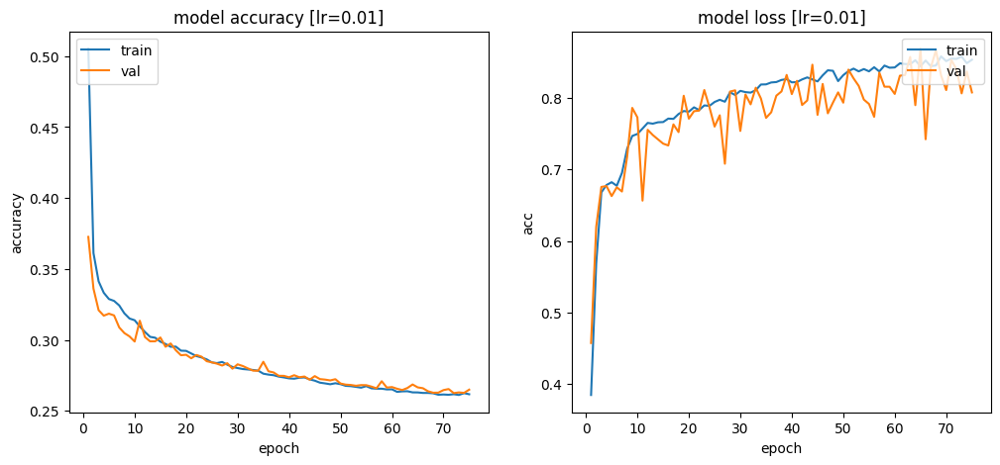

for model
 Model: "SRResNet"
┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)              ┃ Output Shape           ┃        Param # ┃ Connected to           ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━┩
│ input_layer_4             │ (None, None, None, 3)  │              0 │ -                      │
│ (InputLayer)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ Conv_ip (Conv2D)          │ (None, None, None, 64) │         15,616 │ input_layer_4[0][0]    │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ prelu_ip (PReLU)          │ (None, None, None, 64) │             64 │ Conv_ip[0][0]          │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│

['/content/drive/My Drive/AMLS2/metrics/metrics_2025_03_15_at_143502.xlsx',
 '/content/drive/My Drive/AMLS2/metrics/summary_2025_03_15_at_143502.txt',
 RunResult(min_loss=0.38489586114883423, max_acc=0.5052120685577393, last_loss=0.8532171845436096, last_acc=0.26175397634506226, min_val_loss=0.45747581124305725, max_val_acc=0.37261199951171875, last_val_loss=0.8075529336929321, last_val_acc=0.2649703919887543, var_loss=0.005215891208314377, var_acc=0.0011384470769790162),
 HyperParameters(learning_rate=0.01, kernel_size=3, num_epochs=75, optimise='Adam', loss='sparse_categorical_crossentropy', num_filter=128, strides=2, padding='same', dropout_rate=0.25, layers=4, default_activation='relu')]

In [24]:
## output graphs and save metrics files
ac.graph_and_save(history,summary_content,item,filebase)

1/1 ━━━━━━━━━━━━━━━━━━━━ 3s 3s/step
low & pred


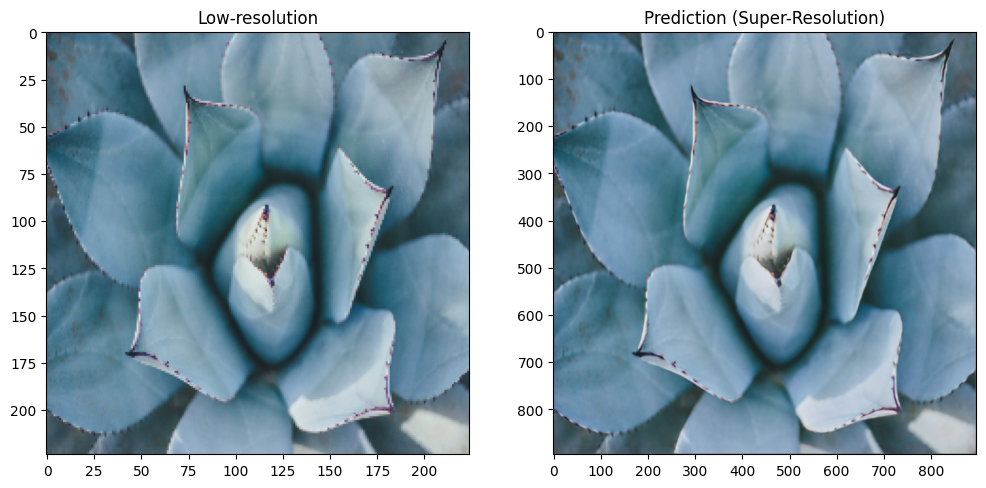

high & pred


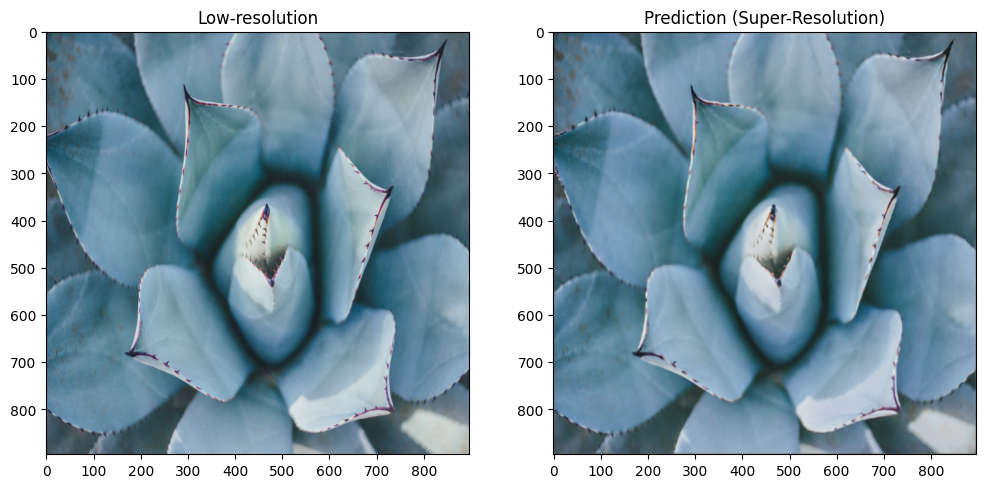

psnr2 79.9658923385375
Using win_size: 7
High-res shape: (896, 896, 3)
Preds shape: (896, 896, 3)
ssim 0.8911279
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step
low & pred


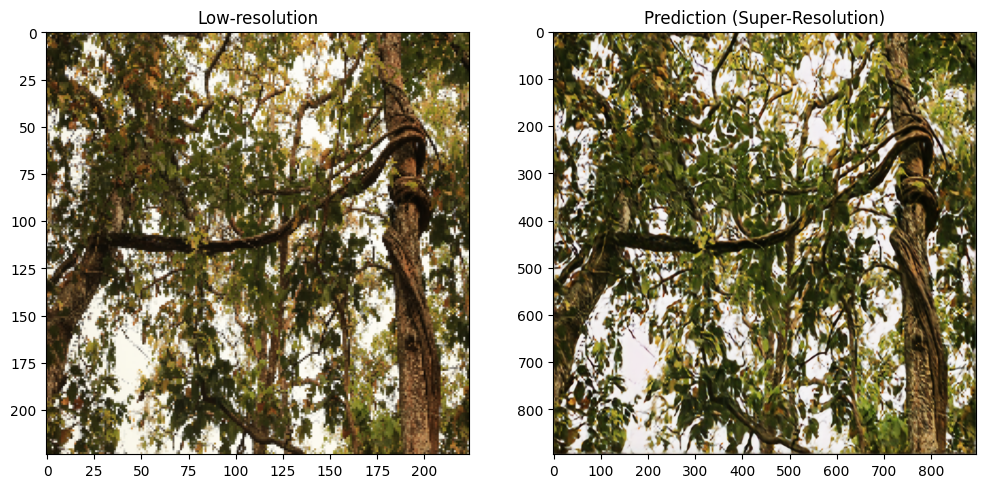

high & pred


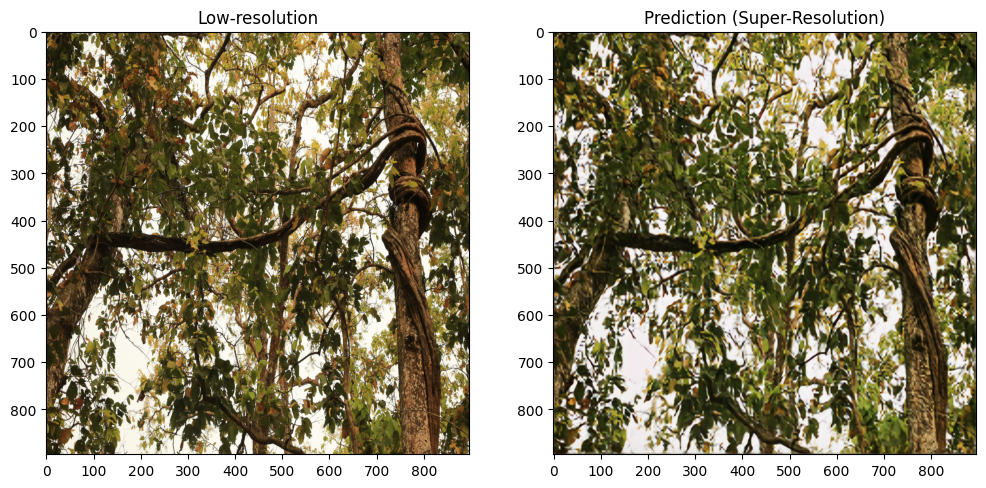

psnr2 65.28614332654409
Using win_size: 7
High-res shape: (896, 896, 3)
Preds shape: (896, 896, 3)
ssim 0.6040394
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step
low & pred


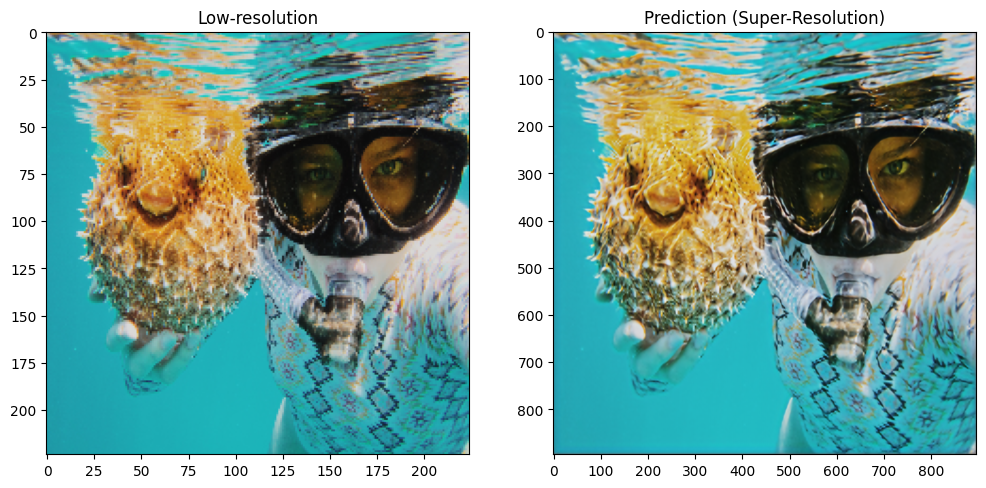

high & pred


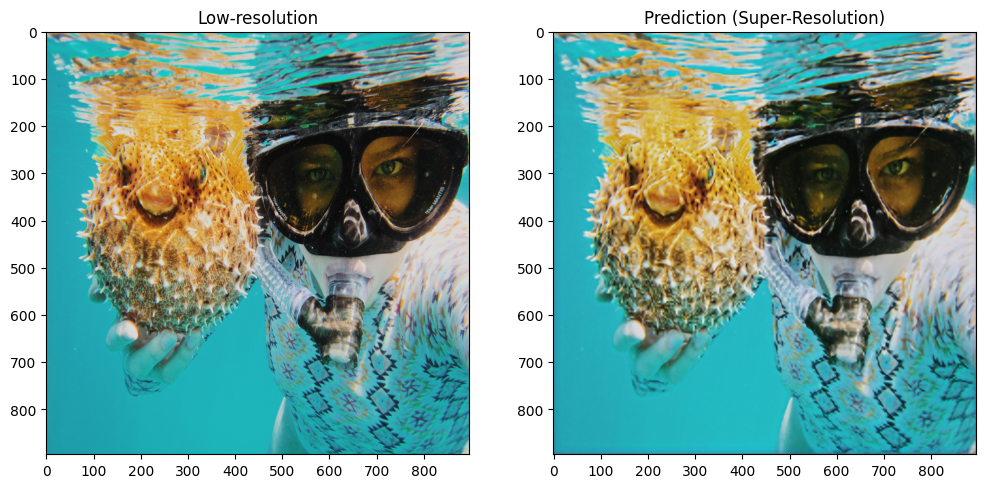

psnr2 72.74131824948721
Using win_size: 7
High-res shape: (896, 896, 3)
Preds shape: (896, 896, 3)
ssim 0.8015899
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 55ms/step
low & pred


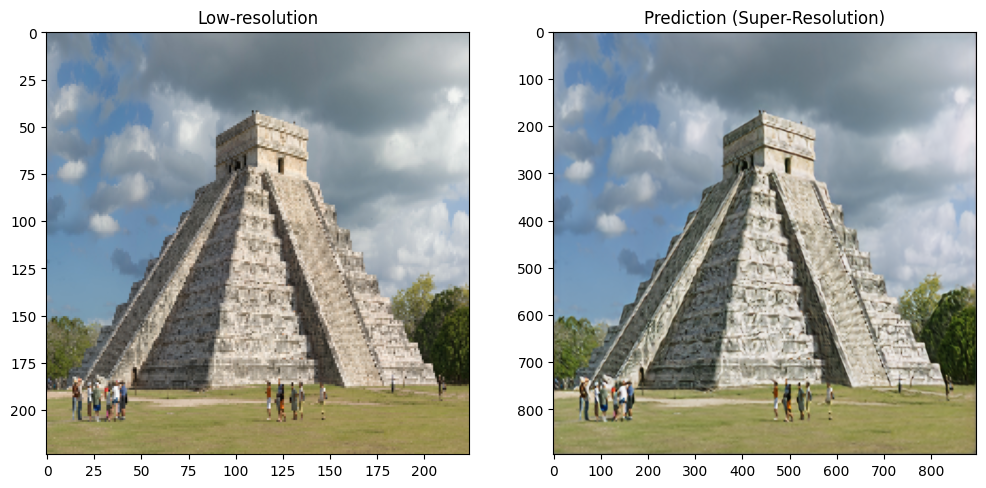

high & pred


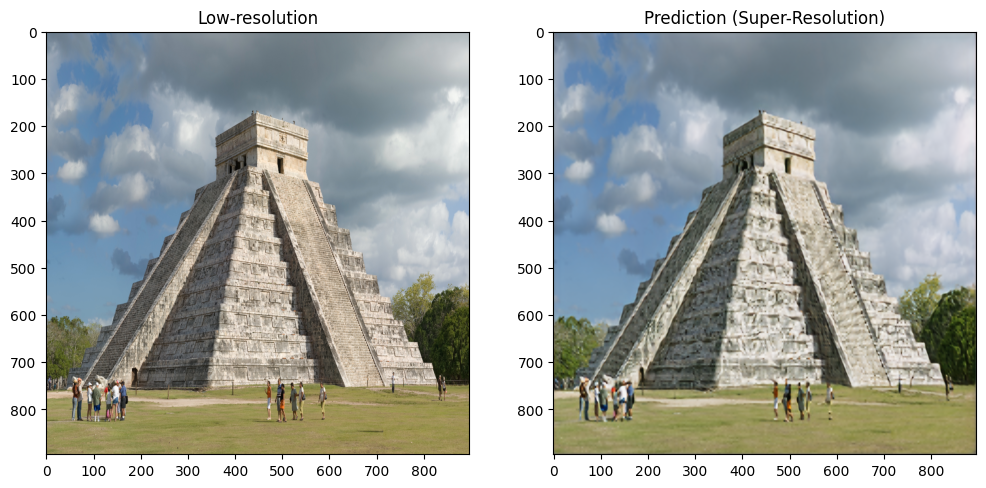

psnr2 71.65326883771353
Using win_size: 7
High-res shape: (896, 896, 3)
Preds shape: (896, 896, 3)
ssim 0.7549343
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step
low & pred


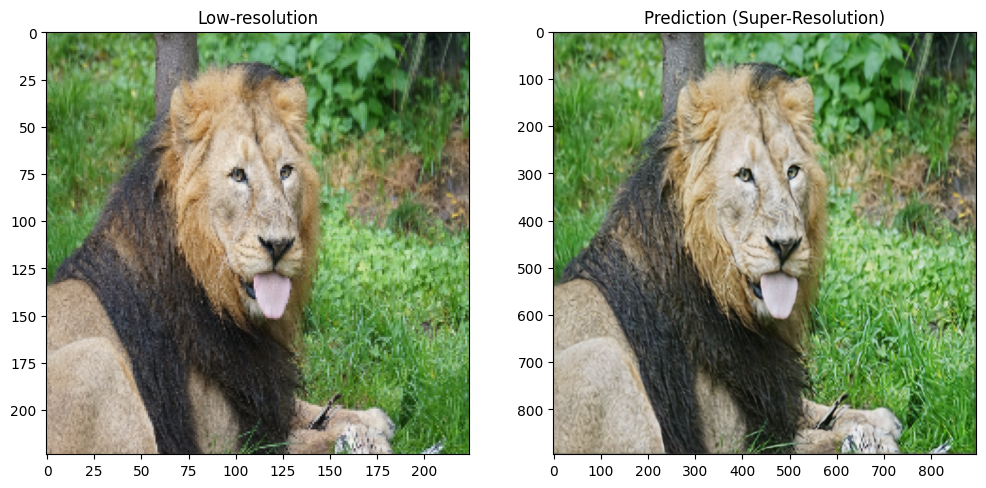

high & pred


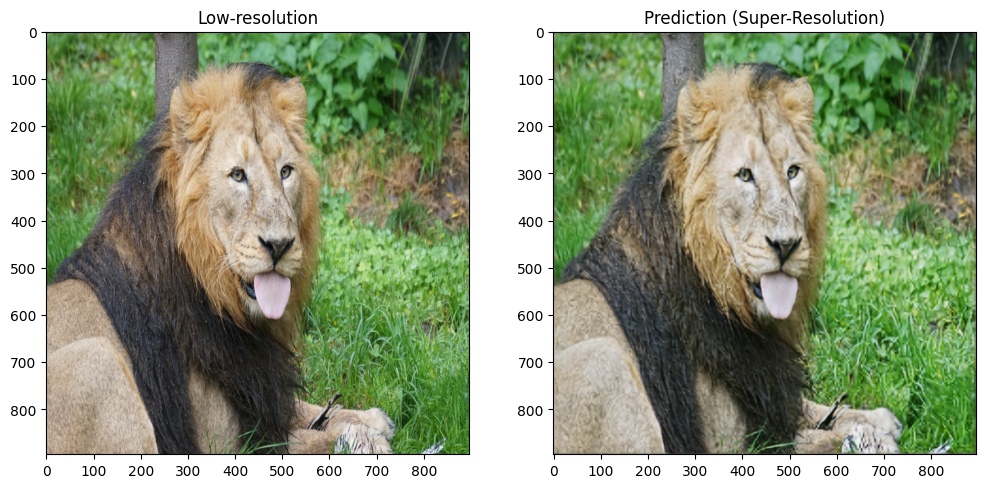

psnr2 73.37944319226675
Using win_size: 7
High-res shape: (896, 896, 3)
Preds shape: (896, 896, 3)
ssim 0.7329934
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 55ms/step
low & pred


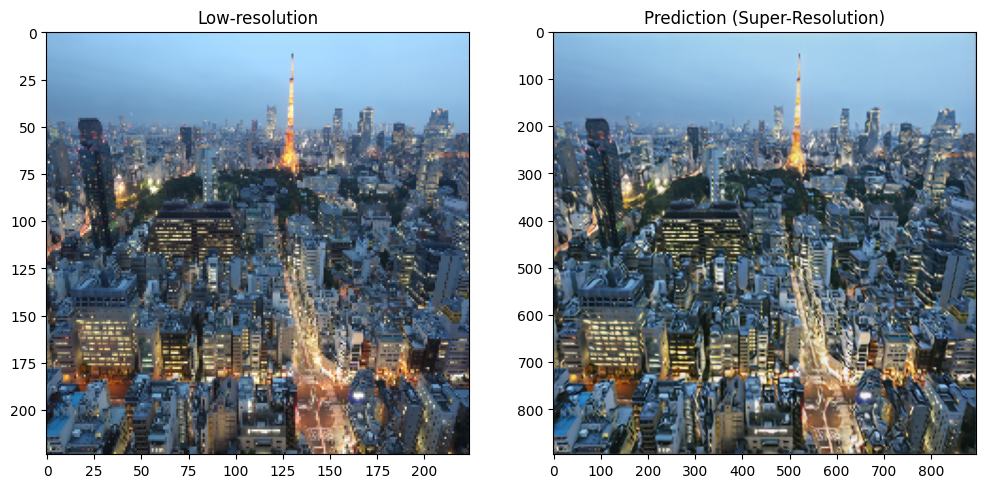

high & pred


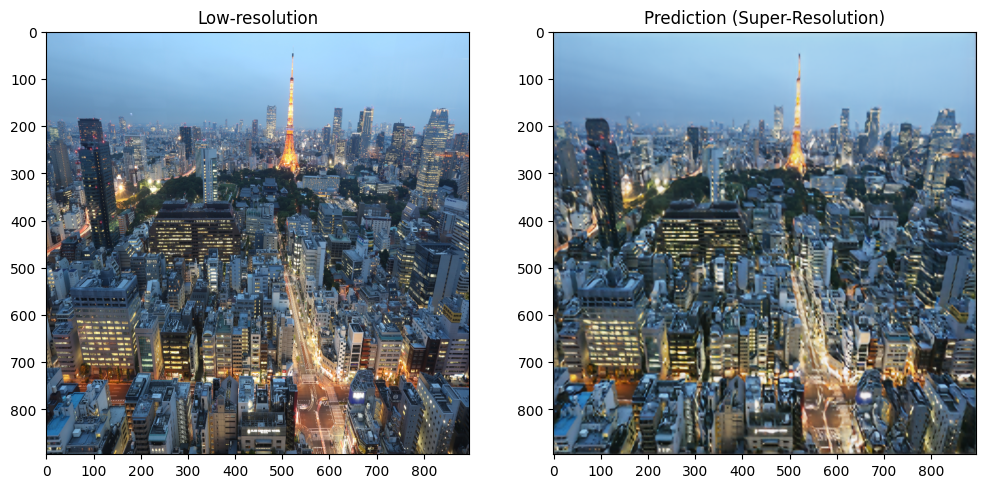

psnr2 68.65373899915151
Using win_size: 7
High-res shape: (896, 896, 3)
Preds shape: (896, 896, 3)
ssim 0.64055556
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 53ms/step
low & pred


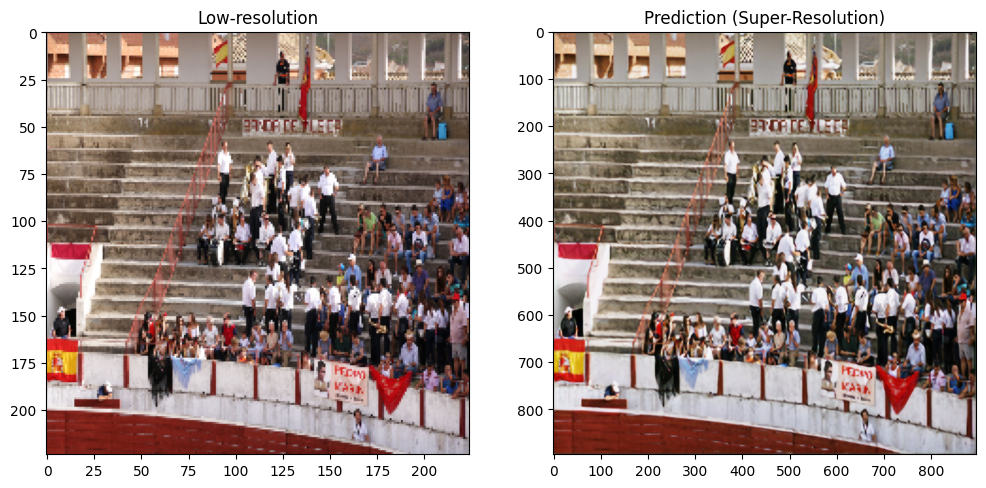

high & pred


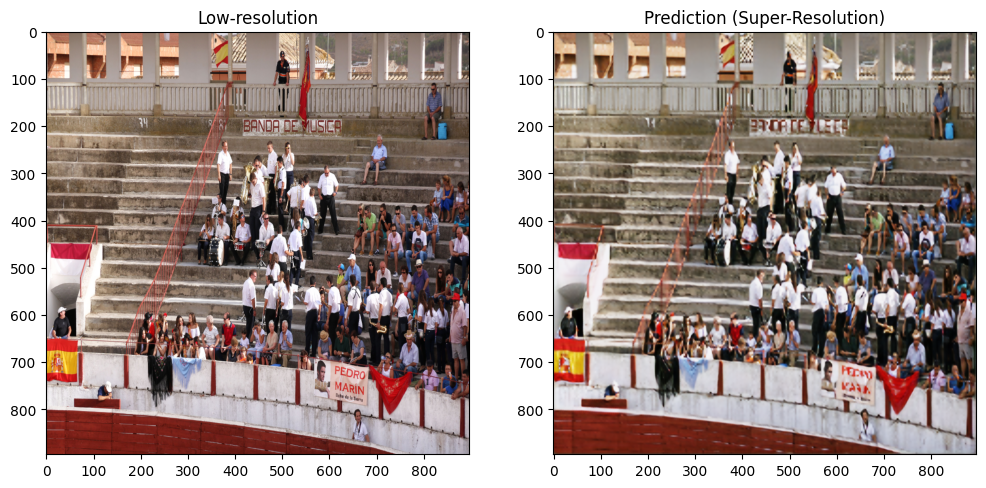

psnr2 69.61958696820669
Using win_size: 7
High-res shape: (896, 896, 3)
Preds shape: (896, 896, 3)
ssim 0.7063651
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 53ms/step
low & pred


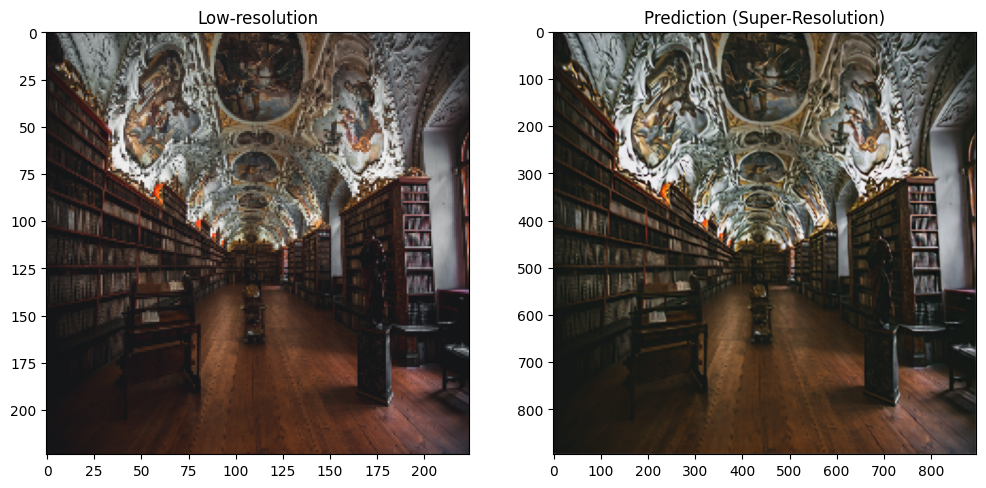

high & pred


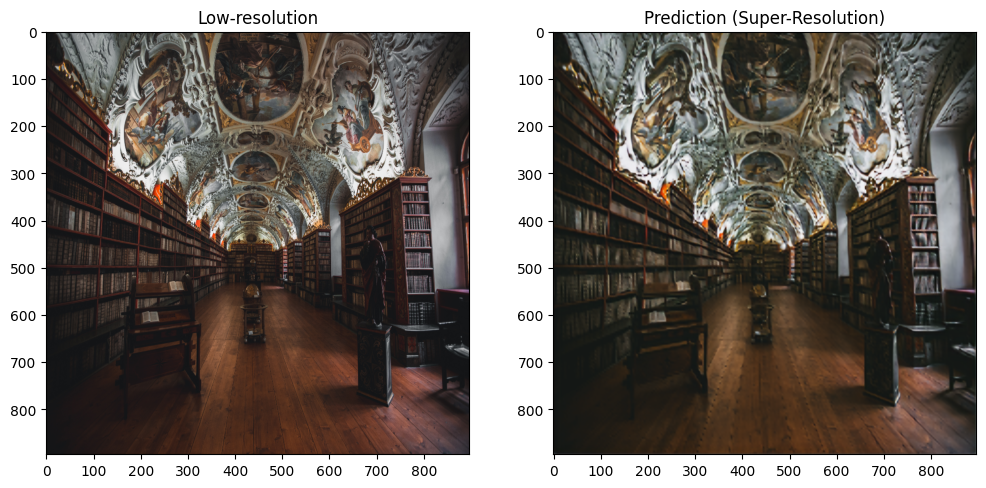

psnr2 71.32150223233633
Using win_size: 7
High-res shape: (896, 896, 3)
Preds shape: (896, 896, 3)
ssim 0.7685539
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 53ms/step
low & pred


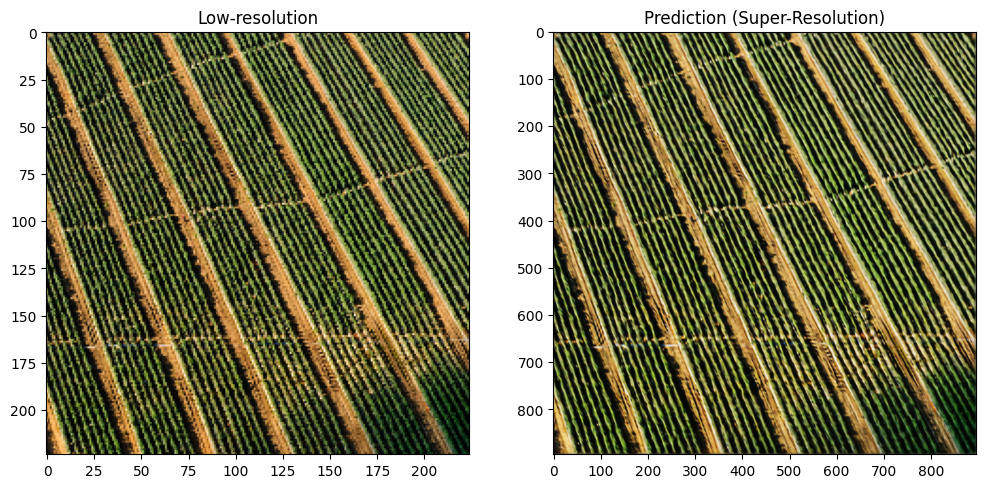

high & pred


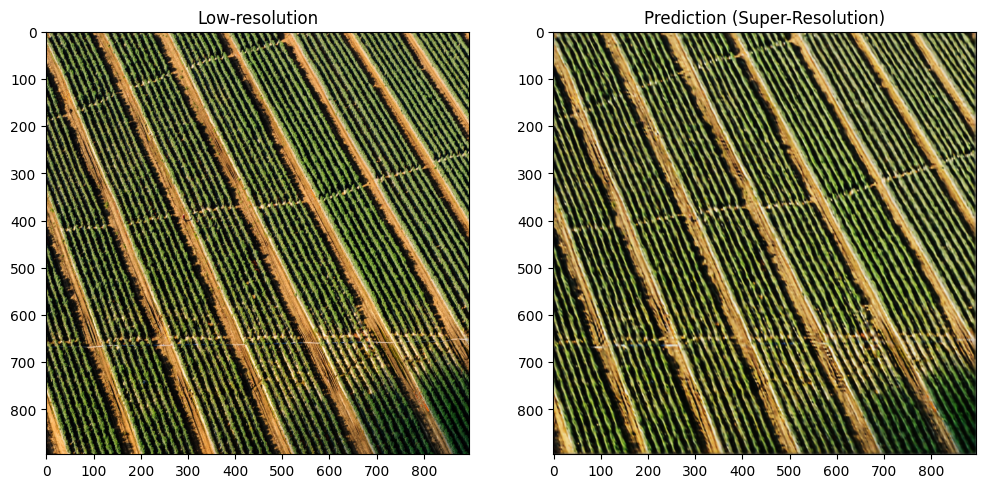

psnr2 66.64530327298574
Using win_size: 7
High-res shape: (896, 896, 3)
Preds shape: (896, 896, 3)
ssim 0.70661116
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step
low & pred


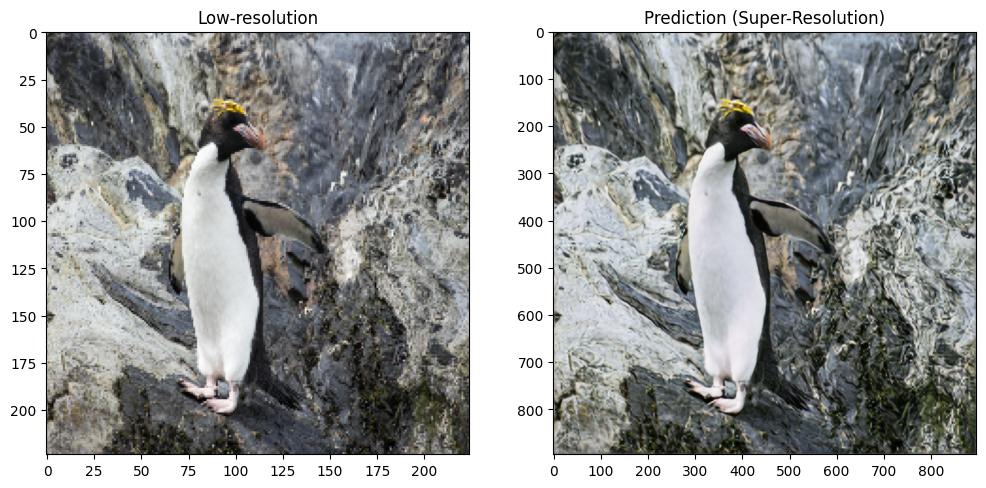

high & pred


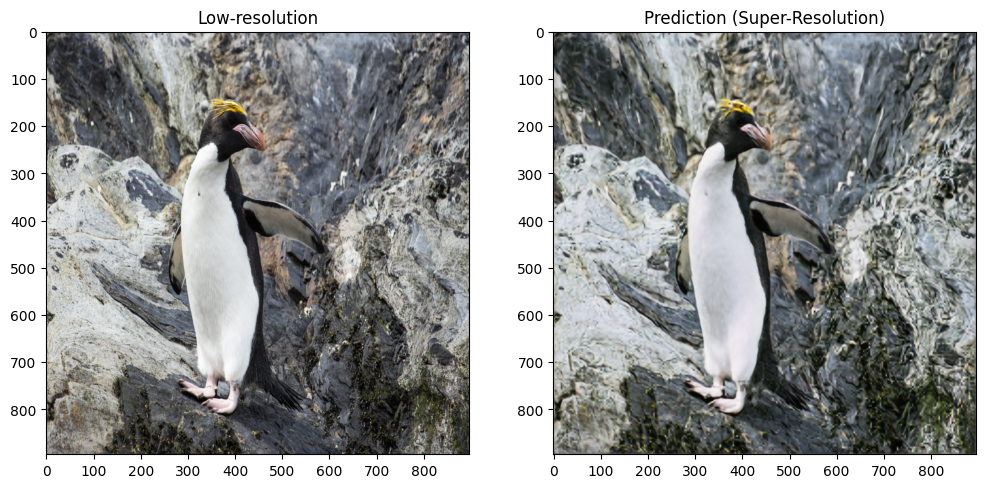

psnr2 71.35051062085562
Using win_size: 7
High-res shape: (896, 896, 3)
Preds shape: (896, 896, 3)
ssim 0.7219138
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 55ms/step
low & pred


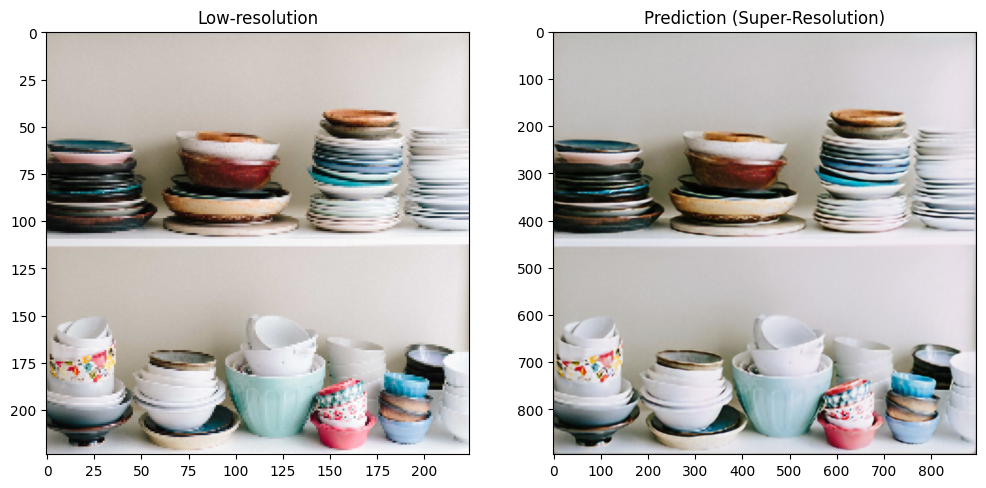

high & pred


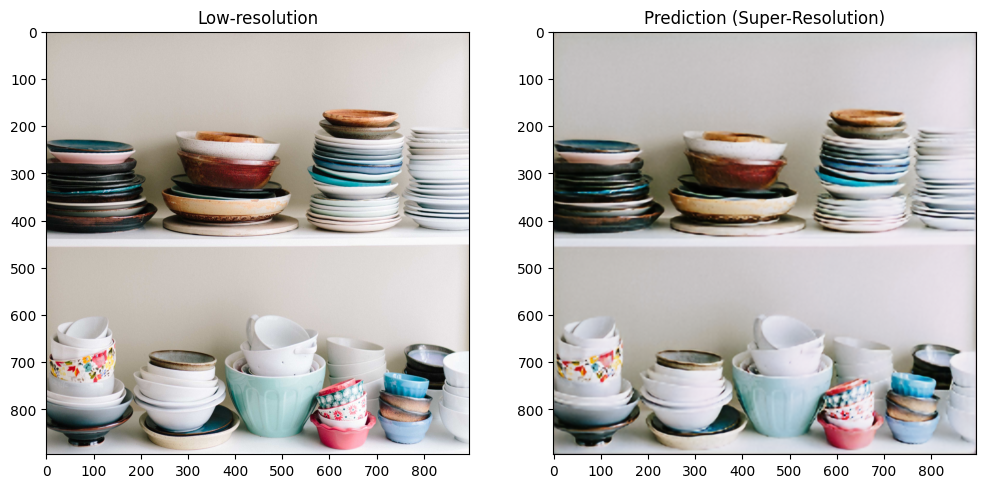

psnr2 74.62648680188589
Using win_size: 7
High-res shape: (896, 896, 3)
Preds shape: (896, 896, 3)
ssim 0.8711588
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 56ms/step
low & pred


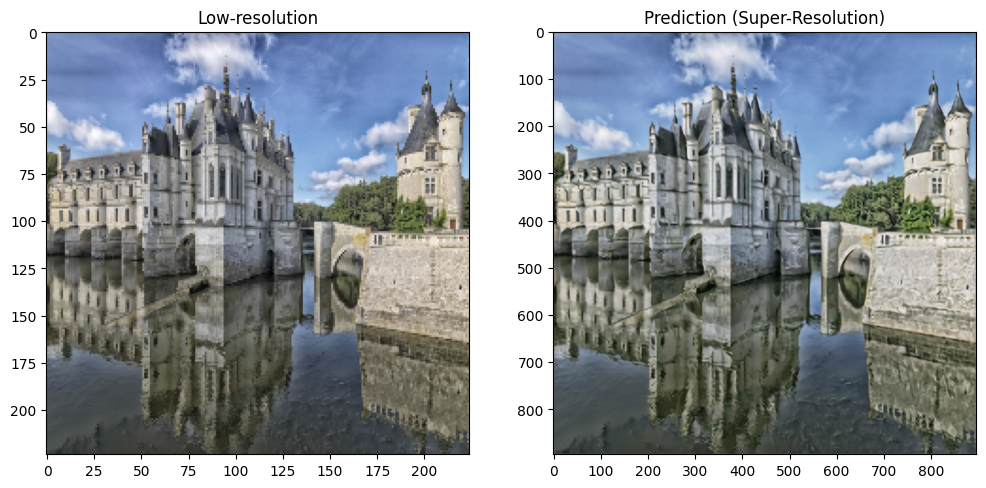

high & pred


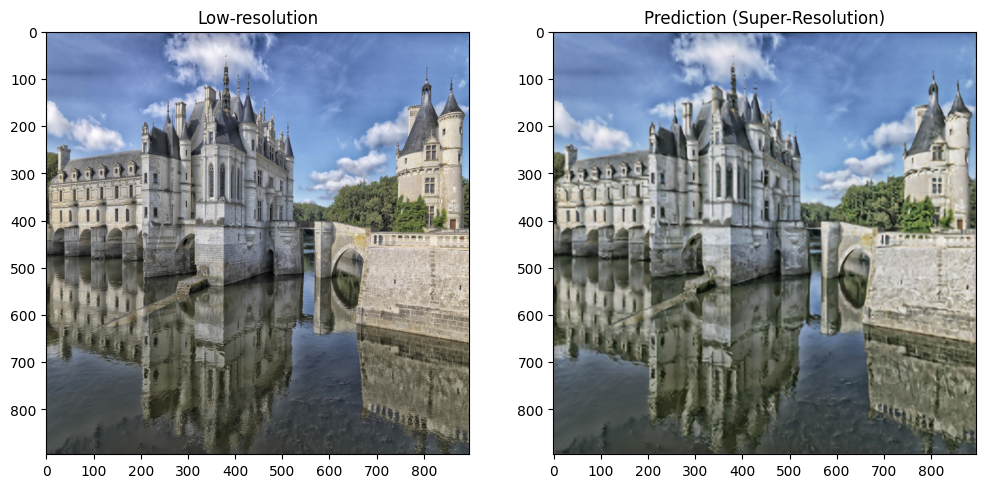

psnr2 72.23365118482046
Using win_size: 7
High-res shape: (896, 896, 3)
Preds shape: (896, 896, 3)
ssim 0.7330305
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 55ms/step
low & pred


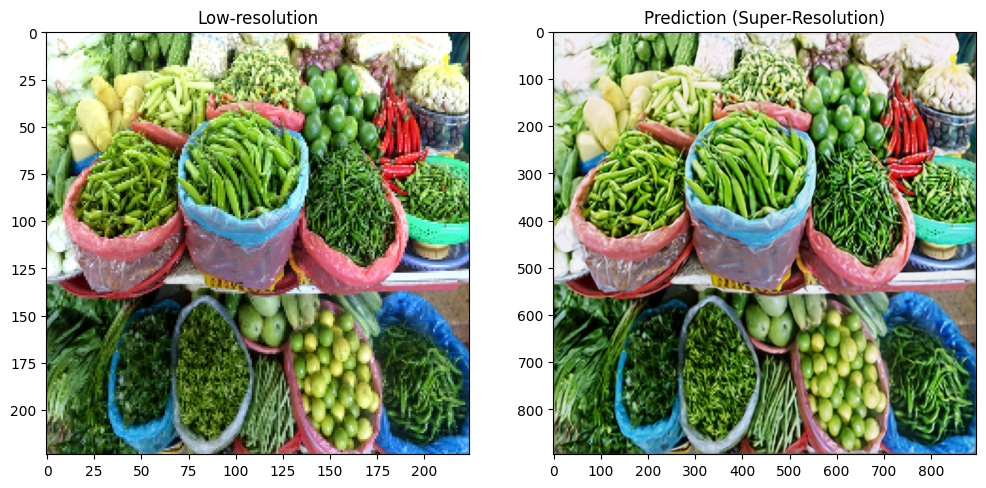

high & pred


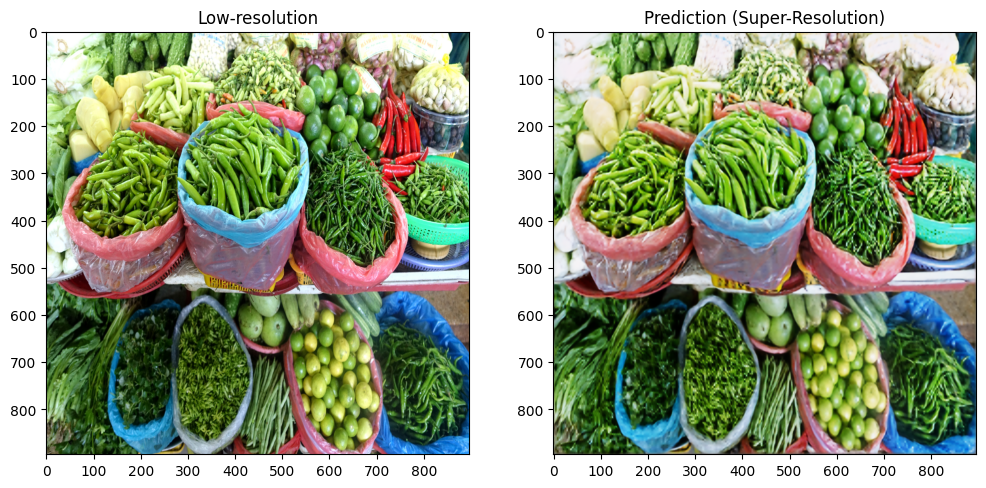

psnr2 70.02951433637075
Using win_size: 7
High-res shape: (896, 896, 3)
Preds shape: (896, 896, 3)
ssim 0.7686271


In [25]:

# Take BATCH_SIZE images from validation dataset
for lowres, highres in val_dataset.take(50):
    # Extract first image from batch
    lowres  = lowres[0].numpy()  # Convert Tensor to NumPy array
    highres = highres[0].numpy()

    # Resize instead of cropping
    lowres = tf.image.resize(lowres, (224, 224)).numpy()

    # Expand dims to match model input shape
    lowres_input = np.expand_dims(lowres, axis=0)  # Shape: (1, 224, 224, 3)

    # Get predictions
    preds = model.predict(lowres_input)  # Model outputs batch shape (1, H, W, C)
    preds = preds[0]  # Remove batch dimension

    # Plot results
    print("low & pred")
    plot_results(lowres, preds)
    print("high & pred")
    plot_results(highres, preds)
    ##print("psnr1",calculate_psnr(lowres,preds))
    print("psnr2",calculate_psnr(highres,preds))
    # Find the smallest dimension
    min_dim = min(highres.shape[0], highres.shape[1], preds.shape[0], preds.shape[1])

    # Ensure win_size is at most min_dim and at least 3 (since SSIM requires an odd number ≥3)
    win_size = min(min_dim, 7)
    win_size = max(win_size, 3)  # Ensure it's at least 3
    win_size = win_size - 1 if win_size % 2 == 0 else win_size  # Ensure odd
    print("Using win_size:", win_size)  # Debugging step
    print("High-res shape:", highres.shape)
    print("Preds shape:", preds.shape)
    print("ssim",ssim(highres,preds,channel_axis=-1,win_size=win_size, data_range=1.0))